# Endothelial cells on a lumen chip - Flow vs. Static
## Goal: Compare cell types, DEGs of sprouting endothelial cells in an artificial lumen in two conditions - Flow and Static

### Dataset generation: 10xgenomics v3.1, one lane per condition. Indexed as SI-F6 for Flow, SI-GA-E6 for Static. Sequenced on a S1 (2x50),  28-8-0-91.
Data received on 30-03-2022

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import scanpy as sc
import numpy as np
import os
import anndata
#import scrublet as scr
from scipy import sparse
import seaborn as sns


In [2]:
%matplotlib inline

In [3]:
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=600, frameon=True, vector_friendly=True, fontsize=20, figsize=None, color_map=None, format='png', facecolor=None, transparent=False, ipython_format='png2x')
color_cond = ["#ff8000", "#800000"]

In [4]:
figures = r"E:"

# -----------------------------------------------------------------------------
# don´t change anything in this part of the code 

In [7]:
datafiles = [r"E:\42_09_19_flow\outs\filtered_feature_bc_matrix.h5",
             r"E:\42_09_19_static\outs\filtered_feature_bc_matrix.h5"]

In [8]:
names = ["42_19_flow", "42_19_static"]
adatas = {n:sc.read_10x_h5(irgendwas) for n,irgendwas in zip(names, datafiles)}

C:\Users\MarenMarder\anaconda3\Lib\site-packages\anndata\_core\anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\MarenMarder\anaconda3\Lib\site-packages\anndata\_core\anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\MarenMarder\anaconda3\Lib\site-packages\anndata\_core\anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
C:\Users\MarenMarder\anaconda3\Lib\site-packages\anndata\_core\anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [9]:
adatas

{'42_19_flow': AnnData object with n_obs × n_vars = 6593 × 36601
     var: 'gene_ids', 'feature_types', 'genome',
 '42_19_static': AnnData object with n_obs × n_vars = 3155 × 36601
     var: 'gene_ids', 'feature_types', 'genome'}

In [10]:
for name, adata in adatas.items():
   adata.obs_names = [name+"_"+elem for elem in adata.obs_names]
   adata.var_names_make_unique()

In [11]:
adatas["42_19_flow"].obs_names

Index(['42_19_flow_AAACCCAAGATGAATC-1', '42_19_flow_AAACCCAAGTATGACA-1',
       '42_19_flow_AAACCCACACAGGATG-1', '42_19_flow_AAACCCAGTCGAGTTT-1',
       '42_19_flow_AAACCCAGTTGGAGAC-1', '42_19_flow_AAACCCATCAGAGTTC-1',
       '42_19_flow_AAACGAAAGGCGACAT-1', '42_19_flow_AAACGAACAAGAGATT-1',
       '42_19_flow_AAACGAACAATTTCTC-1', '42_19_flow_AAACGAACACTTGGCG-1',
       ...
       '42_19_flow_TTTGGTTTCTCCAAGA-1', '42_19_flow_TTTGTTGAGTAGAGTT-1',
       '42_19_flow_TTTGTTGCAAGGCCTC-1', '42_19_flow_TTTGTTGCAAGTGGCA-1',
       '42_19_flow_TTTGTTGCACCATTCC-1', '42_19_flow_TTTGTTGCATAGGCGA-1',
       '42_19_flow_TTTGTTGGTTTGGGAG-1', '42_19_flow_TTTGTTGTCACACGAT-1',
       '42_19_flow_TTTGTTGTCACCCTTG-1', '42_19_flow_TTTGTTGTCTTTCCGG-1'],
      dtype='object', length=6593)

In [12]:
adatas["42_19_static"].obs_names

Index(['42_19_static_AAACCCACACAGGATG-1', '42_19_static_AAACGAACATCCTCAC-1',
       '42_19_static_AAACGAATCATCCTGC-1', '42_19_static_AAACGCTAGTGCACAG-1',
       '42_19_static_AAACGCTCAACACGTT-1', '42_19_static_AAACGCTGTCCTCATC-1',
       '42_19_static_AAACGCTTCTGTACAG-1', '42_19_static_AAACGCTTCTTGGATG-1',
       '42_19_static_AAAGAACAGCTCGCAC-1', '42_19_static_AAAGAACAGGCCACTC-1',
       ...
       '42_19_static_TTTGGAGAGTGCAGCA-1', '42_19_static_TTTGGAGCAAGATGGC-1',
       '42_19_static_TTTGGAGGTACCCAGC-1', '42_19_static_TTTGGAGGTACTCGCG-1',
       '42_19_static_TTTGGAGTCGATCCAA-1', '42_19_static_TTTGGAGTCTGGCCAG-1',
       '42_19_static_TTTGTTGCAAGGCCTC-1', '42_19_static_TTTGTTGCAAGTGGCA-1',
       '42_19_static_TTTGTTGGTTTGGGAG-1', '42_19_static_TTTGTTGTCACCCTTG-1'],
      dtype='object', length=3155)

# Adata Concatenate

In [13]:
# correct settings to join the adatas without losing genes
# make sure that join='inner'

adata = anndata.concat(adatas, label = "id", axis= 0)
adata.obs_names_make_unique()

In [14]:
adata

AnnData object with n_obs × n_vars = 9748 × 36601
    obs: 'id'

In [15]:
adata.obs.id.value_counts()

id
42_19_flow      6593
42_19_static    3155
Name: count, dtype: int64

In [16]:
adata.obs

,id
42_19_flow_AAACCCAAGATGAATC-1,42_19_flow
42_19_flow_AAACCCAAGTATGACA-1,42_19_flow
42_19_flow_AAACCCACACAGGATG-1,42_19_flow
42_19_flow_AAACCCAGTCGAGTTT-1,42_19_flow
42_19_flow_AAACCCAGTTGGAGAC-1,42_19_flow
...,...
42_19_static_TTTGGAGTCTGGCCAG-1,42_19_static
42_19_static_TTTGTTGCAAGGCCTC-1,42_19_static
42_19_static_TTTGTTGCAAGTGGCA-1,42_19_static
42_19_static_TTTGTTGGTTTGGGAG-1,42_19_static


## cell counts before filtering

In [17]:
df1 = adata.obs.id.value_counts()
df2 = df1.to_frame().reset_index()
df2.info()
df2['Observation']  = "before filtering"
df2

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2 entries, 0 to 1
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype   
---  ------  --------------  -----   
 0   id      2 non-null      category
 1   count   2 non-null      int64   
dtypes: category(1), int64(1)
memory usage: 274.0 bytes


,id,count,Observation
0,42_19_flow,6593,before filtering
1,42_19_static,3155,before filtering


<Axes: xlabel='id', ylabel='count'>

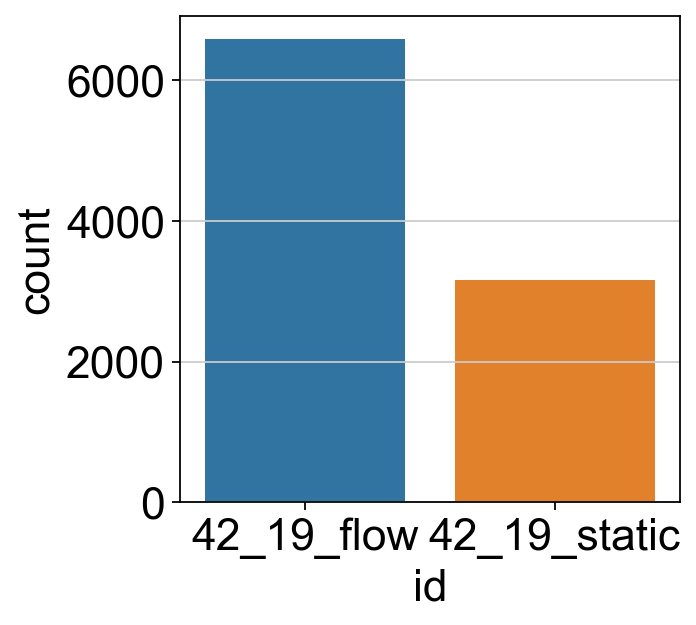

In [22]:
sns.barplot(x= "id", y = "count", data = df2
           )

# Finding Doublets
Once doublet tool is imported, no graphs can becomputed anymore (as of 30.08.2023)--> doublet paramters are saved from adata version "filtered_unnormalized_file.h5ad" which was executed one time and this version was used for all downstream analysis from then

In [101]:
# import scrublet
# scrub = scr.Scrublet(adata.X, expected_doublet_rate = 0.076)

In [30]:
# adata.obs['doublet_scores'], adata.obs['predicted_doublets'] = scrub.scrub_doublets(min_counts=2, min_cells=3, 
#                                                            min_gene_variability_pctl=85, n_prin_comps=30)

In [31]:
# scrub.plot_histogram()
# plt.savefig('doublets.png', format='png', dpi=1200, fontsize=14, figsize=None, color_map=None, facecolor=None, transparent=False)

In [20]:
# scrub.set_embedding('UMAP', scr.get_umap(scrub.manifold_obs_, 10, min_dist=0.3))
# scrub.plot_embedding('UMAP', order_points=True);

In [21]:
#adata.obs['predicted_doublets'].value_counts()

In [22]:
#adata.obs

# Preprocessing and Quality Control

In [23]:
adata.var['mt'] = adata.var_names.str.contains('MT-', case=False)  # annotate the group of mitochondrial genes as 'mt'

sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

In [24]:
%matplotlib inline

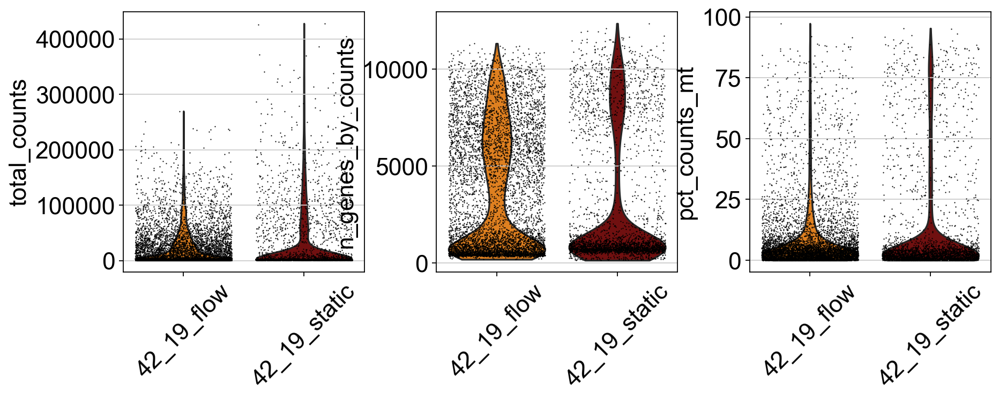

In [25]:
with plt.rc_context({'font.size': 20}):
    sc.pl.violin(adata, ['total_counts', 'n_genes_by_counts', 'pct_counts_mt'], jitter=0.4, 
                 multi_panel=True, groupby='id', rotation=45, palette=["#ff8000", "#800000"], save=('qc_before_filtering.svg'))

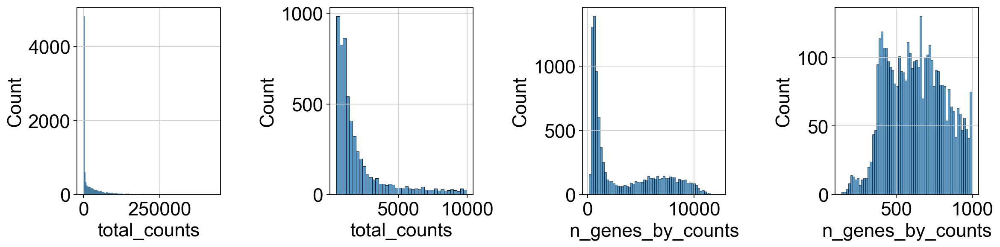

In [26]:
fig, axs = plt.subplots(1, 4, figsize=(15, 4))
sns.histplot(adata.obs["total_counts"], kde=False, ax=axs[0])
sns.histplot(adata.obs["total_counts"][adata.obs["total_counts"] < 10000], kde=False, bins=40, ax=axs[1])
sns.histplot(adata.obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[2])
sns.histplot(adata.obs["n_genes_by_counts"][adata.obs["n_genes_by_counts"] < 1000], kde=False, bins=60, ax=axs[3])



plt.tight_layout()

plt.show()

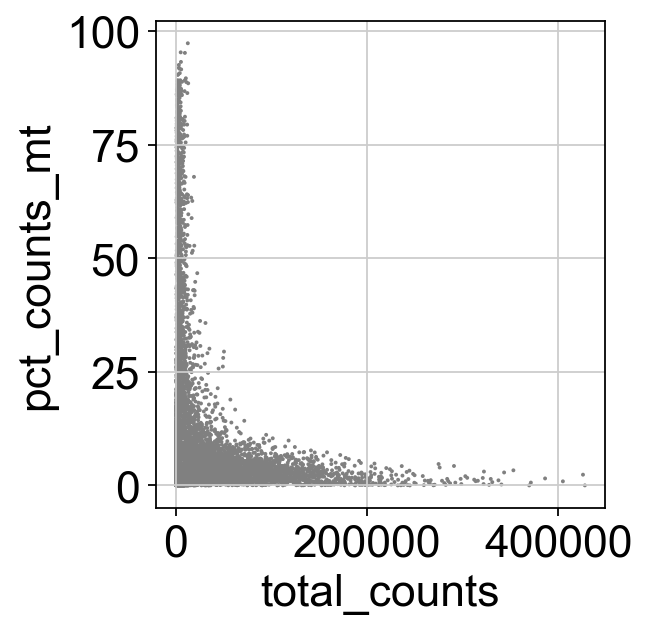

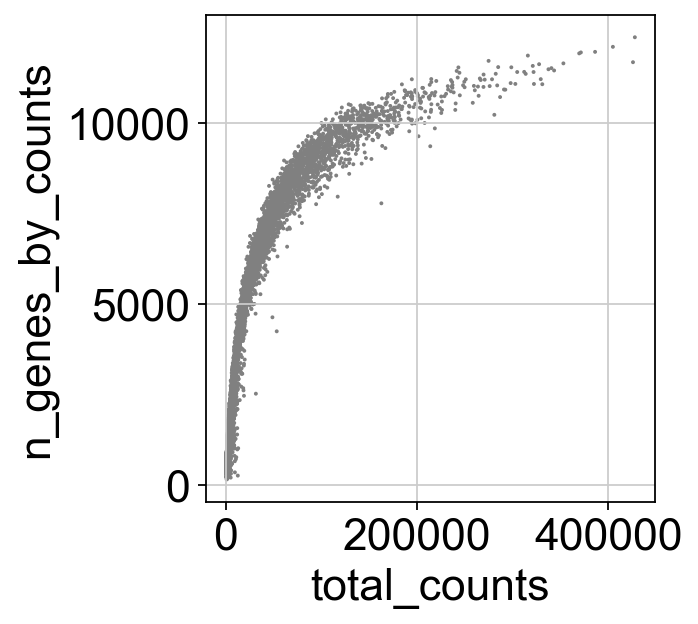

In [27]:
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [28]:
adata

AnnData object with n_obs × n_vars = 9748 × 36601
    obs: 'id', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

# reading important data from adata

### cell number with less than 200 genes 

In [29]:
ge1 = pd.crosstab(adata.obs['n_genes_by_counts'],adata.obs["total_counts"], normalize='index')
ge1= ge1.reset_index()
ge1

total_counts,n_genes_by_counts,500.0,501.0,502.0,503.0,504.0,505.0,506.0,507.0,508.0,...,337364.0,340458.0,343278.0,352982.0,369497.0,371243.0,386093.0,404709.0,425711.0,427669.0
0,141,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,152,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,166,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,168,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,175,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4896,11911,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
4897,11937,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
4898,11953,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
4899,12092,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


In [30]:
ge1.loc[ge1["n_genes_by_counts"] < 200]

total_counts,n_genes_by_counts,500.0,501.0,502.0,503.0,504.0,505.0,506.0,507.0,508.0,...,337364.0,340458.0,343278.0,352982.0,369497.0,371243.0,386093.0,404709.0,425711.0,427669.0
0,141,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,152,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,166,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,168,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,175,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,179,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,181,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,184,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,185,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,188,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [31]:
mt2 = pd.crosstab(adata.obs['pct_counts_mt'],adata.obs["id"], normalize='index')
mt2= mt2.reset_index()
mt2

id,pct_counts_mt,42_19_flow,42_19_static
0,0.000000,0.587156,0.412844
1,0.007649,0.000000,1.000000
2,0.008528,0.000000,1.000000
3,0.008850,0.000000,1.000000
4,0.009398,0.000000,1.000000
...,...,...,...
9291,92.552879,0.000000,1.000000
9292,93.211769,0.000000,1.000000
9293,95.198669,0.000000,1.000000
9294,95.316650,0.000000,1.000000


In [32]:
mt2.loc[mt2["pct_counts_mt"] > 10]

id,pct_counts_mt,42_19_flow,42_19_static
7465,10.012674,1.0,0.0
7466,10.018054,1.0,0.0
7467,10.035303,1.0,0.0
7468,10.036415,1.0,0.0
7469,10.038469,0.0,1.0
...,...,...,...
9291,92.552879,0.0,1.0
9292,93.211769,0.0,1.0
9293,95.198669,0.0,1.0
9294,95.316650,0.0,1.0


### Main filterting step

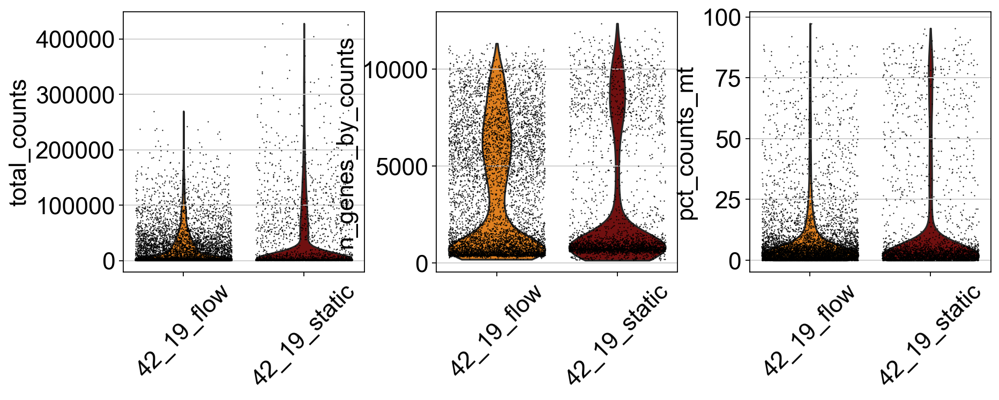

In [33]:
with plt.rc_context({'font.size': 20}):
    sc.pl.violin(adata, ['total_counts', 'n_genes_by_counts', 'pct_counts_mt'], jitter=0.4, 
                 multi_panel=True, groupby='id', rotation=45, palette=["#ff8000", "#800000"])

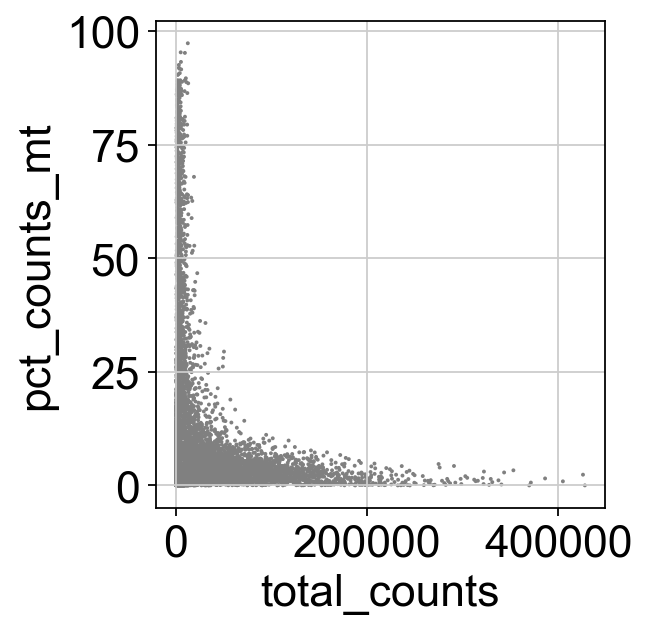

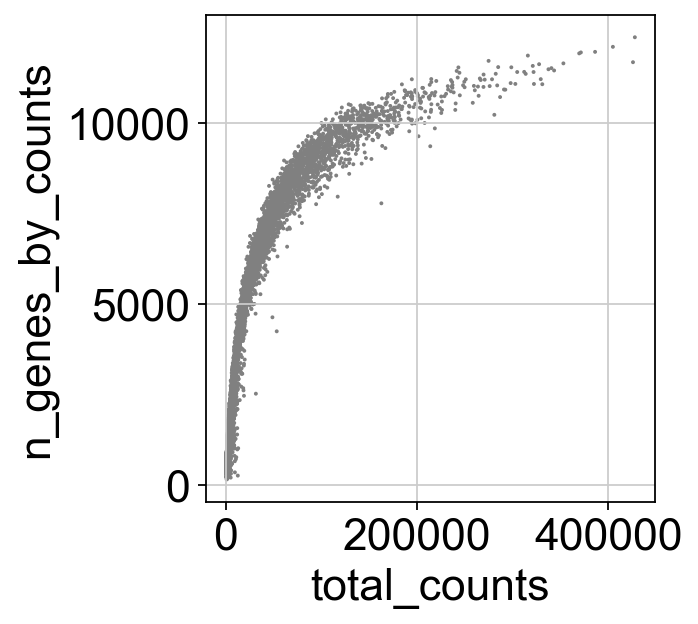

In [34]:
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [35]:
sc.pp.filter_cells(adata, min_counts=3000)
sc.pp.filter_cells(adata, max_counts=60000)
adata = adata[adata.obs["pct_counts_mt"] < 15]
sc.pp.filter_genes(adata, min_cells=10)
sc.pp.filter_cells(adata, min_genes=200)

C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\preprocessing\_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number


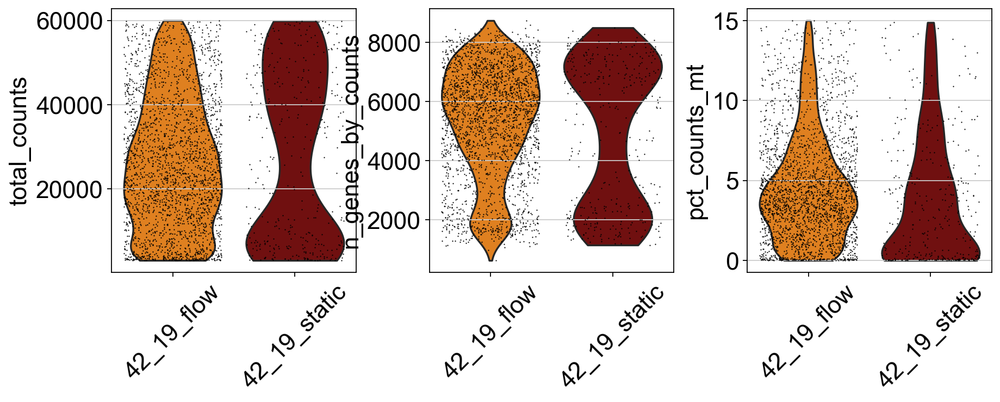

In [36]:
with plt.rc_context({'font.size': 20}):
    sc.pl.violin(adata, ['total_counts', 'n_genes_by_counts', 'pct_counts_mt'],jitter=0.4, wspace=0.8,
                 multi_panel=True, groupby='id', rotation=45, palette=["#ff8000", "#800000"])

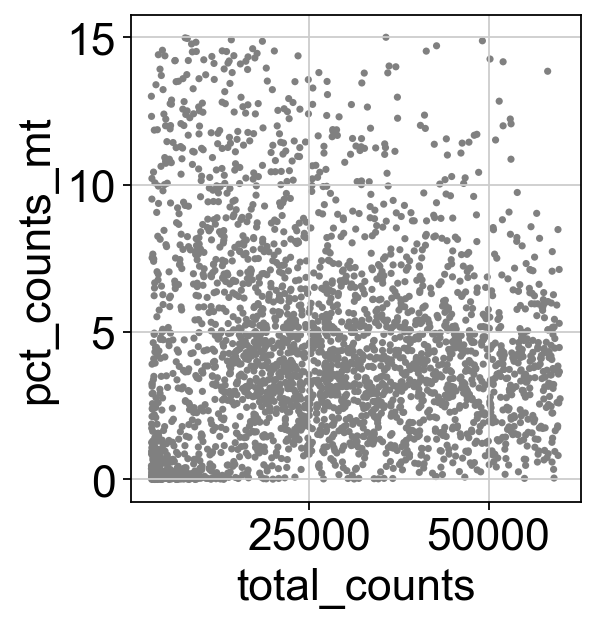

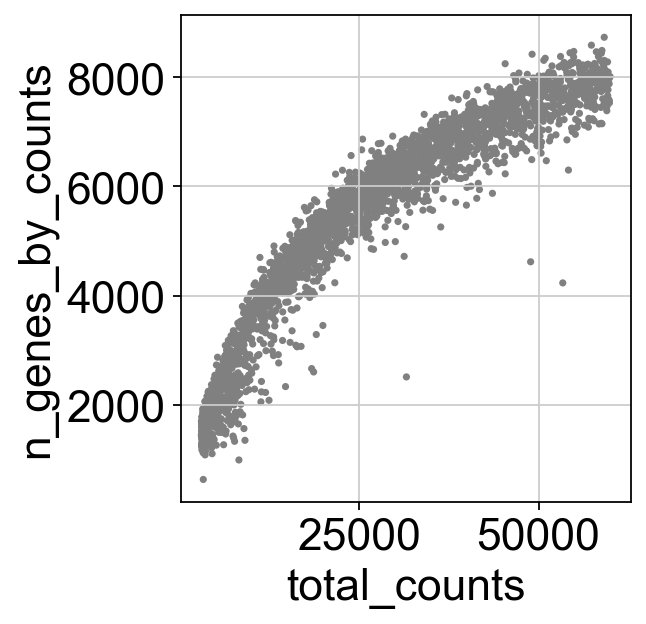

In [37]:
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [38]:
adata

AnnData object with n_obs × n_vars = 2875 × 17886
    obs: 'id', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells'

In [39]:
adata.obs.id.value_counts()

id
42_19_flow      2511
42_19_static     364
Name: count, dtype: int64

In [40]:
adata.obs.id.value_counts()

id
42_19_flow      2511
42_19_static     364
Name: count, dtype: int64

#### Remove ribosomal genes completely

list of KEGG pathway genesets of ribosomal genes from the Broad Institute, Inc., Massachusetts Institute of Technology, and Regents of the University of California(1,2):
https://www.gsea-msigdb.org/gsea/index.jsp

1.	Subramanian, A., Tamayo, P., Mootha, V.K., Mukherjee, S., Ebert, B.L., Gillette, M.A., Paulovich, A., Pomeroy, S.L., Golub, T.R., Lander, E.S., et al. (2005). Gene set enrichment analysis: A knowledge-based approach for interpreting genome-wide expression profiles. Proceedings of the National Academy of Sciences 102, 15545–15550. 10.1073/pnas.0506580102.

2.	Mootha, V.K., Lindgren, C.M., Eriksson, K.-F., Subramanian, A., Sihag, S., Lehar, J., Puigserver, P., Carlsson, E., Ridderstråle, M., Laurila, E., et al. (2003). PGC-1α-responsive genes involved in oxidative phosphorylation are coordinately downregulated in human diabetes. Nat Genet 34, 267–273. 10.1038/ng1180.

In [41]:
# read in list of ribo genes from kegg
ribo_url = "http://software.broadinstitute.org/gsea/msigdb/download_geneset.jsp?geneSetName=KEGG_RIBOSOME&fileType=txt"
ribo_genes = pd.read_table( ribo_url, header=[1])
ribo_genes.head()
# create mask for all ribo genes
ribo_mk = np.in1d( adata.var_names.values.astype(str), ribo_genes)
adata = adata[:,~ribo_mk]

# reading important data from adata

### cell number with more than 10% mitochondrial genes post filtering

In [42]:
mt1 = pd.crosstab(adata.obs['pct_counts_mt'],adata.obs["id"], normalize='index')
mt1= mt1.reset_index()
mt1

id,pct_counts_mt,42_19_flow,42_19_static
0,0.000000,0.583333,0.416667
1,0.007649,0.000000,1.000000
2,0.008850,0.000000,1.000000
3,0.010031,0.000000,1.000000
4,0.012311,0.000000,1.000000
...,...,...,...
2856,14.877294,0.000000,1.000000
2857,14.910917,1.000000,0.000000
2858,14.956305,1.000000,0.000000
2859,14.976660,1.000000,0.000000


In [43]:
mt1.loc[mt1["pct_counts_mt"] > 10]

id,pct_counts_mt,42_19_flow,42_19_static
2609,10.018054,1.0,0.0
2610,10.035303,1.0,0.0
2611,10.038469,0.0,1.0
2612,10.040798,0.0,1.0
2613,10.047938,1.0,0.0
...,...,...,...
2856,14.877294,0.0,1.0
2857,14.910917,1.0,0.0
2858,14.956305,1.0,0.0
2859,14.976660,1.0,0.0


## cell counts after filtering

In [44]:
#cell counts after all filtering steps
df3 = adata.obs.id.value_counts()
df3
df4 = df3.to_frame().reset_index()
df4.info()
df4['Observation']  = "after filtering"
df4

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2 entries, 0 to 1
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype   
---  ------  --------------  -----   
 0   id      2 non-null      category
 1   count   2 non-null      int64   
dtypes: category(1), int64(1)
memory usage: 274.0 bytes


,id,count,Observation
0,42_19_flow,2511,after filtering
1,42_19_static,364,after filtering


<Axes: xlabel='id', ylabel='count'>

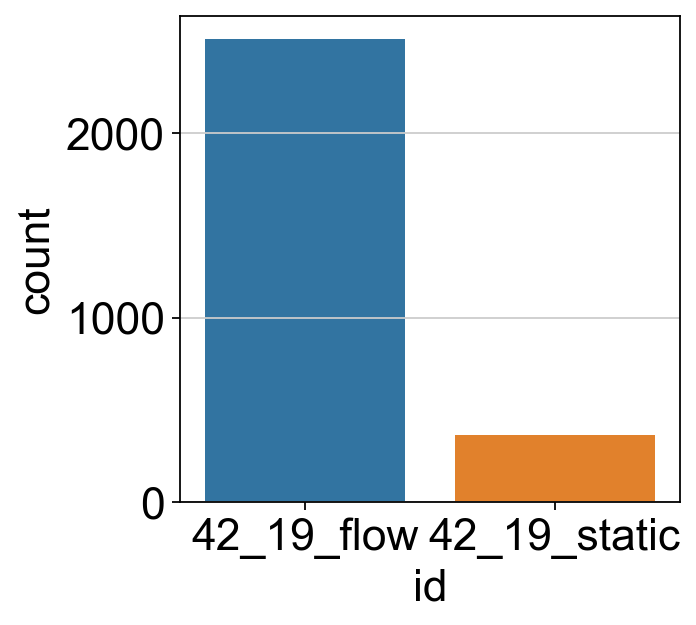

In [45]:
sns.barplot(x= "id", y = "count", data = df4)

#### cell counts combined

(0.0, 7000.0)

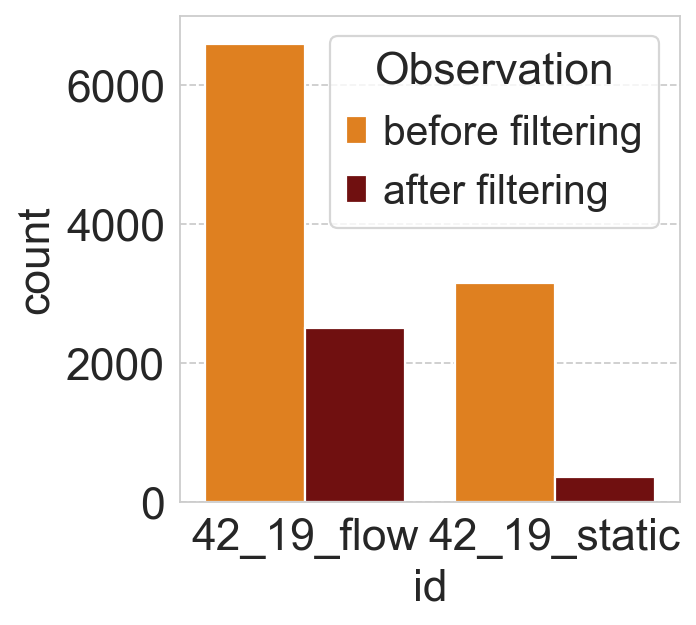

In [46]:
sns.set_style("whitegrid", {'grid.linestyle': '--'})
sns.set_context(rc={"font.size":20, "axes.titlesize":20, "axes.labelsize":20})

combo = [df2,df4]
beforeplusafter= pd.concat(combo)
beforeplusafter
sns.barplot(x= "id", y = "count", hue = "Observation", 
            data = beforeplusafter, palette=["#ff8000", "#800000"] )
plt.ylim(0,7000)

# Save filtered but unnormalized data

In [97]:
filtered_unnormalized_file = r"E:/1_filtered_unnormalized_file.h5ad"

In [95]:
#adata.write(filtered_unnormalized_file)

In [98]:
adata = sc.read(filtered_unnormalized_file)

In [99]:
adata

AnnData object with n_obs × n_vars = 2875 × 17802
    obs: 'id', 'doublet_scores', 'predicted_doublets', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells'

In [100]:
adata.obs

,id,doublet_scores,predicted_doublets,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,n_counts,n_genes
AAACCCAAGTATGACA-1,42_19_flow,0.097742,False,6421,27553.0,1058.0,3.839872,27553.0,6413
AAACCCAGTTGGAGAC-1,42_19_flow,0.183871,False,5702,22460.0,1449.0,6.451469,22460.0,5695
AAACGAAAGGCGACAT-1,42_19_flow,0.089370,False,5298,26301.0,123.0,0.467663,26301.0,5295
AAACGAACAATTTCTC-1,42_19_flow,0.114330,False,3506,9038.0,209.0,2.312459,9038.0,3502
AAACGCTAGTGAGTTA-1,42_19_flow,0.110706,False,6639,32959.0,1132.0,3.434570,32959.0,6631
...,...,...,...,...,...,...,...,...,...
TTTAGTCTCCCAAGCG-1,42_19_static,0.103939,False,3444,13230.0,1740.0,13.151927,13230.0,3444
TTTCACAGTGTCTTCC-1-1,42_19_static,0.183871,False,7442,54309.0,2427.0,4.468873,54309.0,7414
TTTCAGTCAATCGCCG-1,42_19_static,0.063931,False,2553,6715.0,6.0,0.089352,6715.0,2553
TTTCCTCCAGAGTGTG-1,42_19_static,0.086796,False,2437,8158.0,5.0,0.061290,8158.0,2436


# Highly variable genes
## HVGs must be determined seperately for each batch, otherwise it just determines that there are differences between the two samples

In [104]:
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

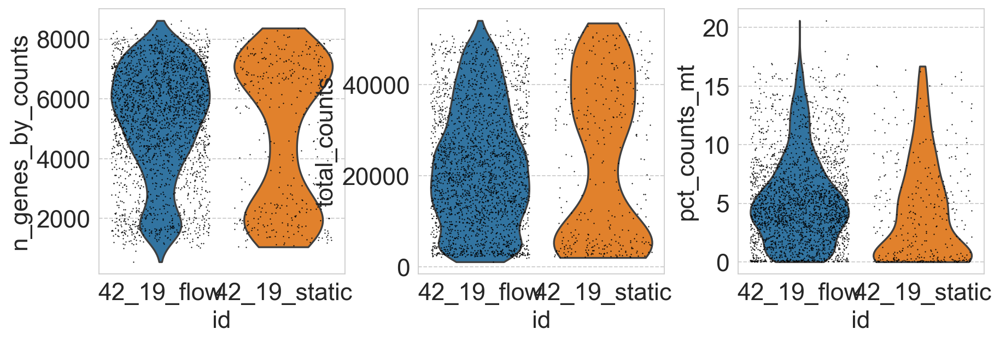

In [105]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True, groupby="id")

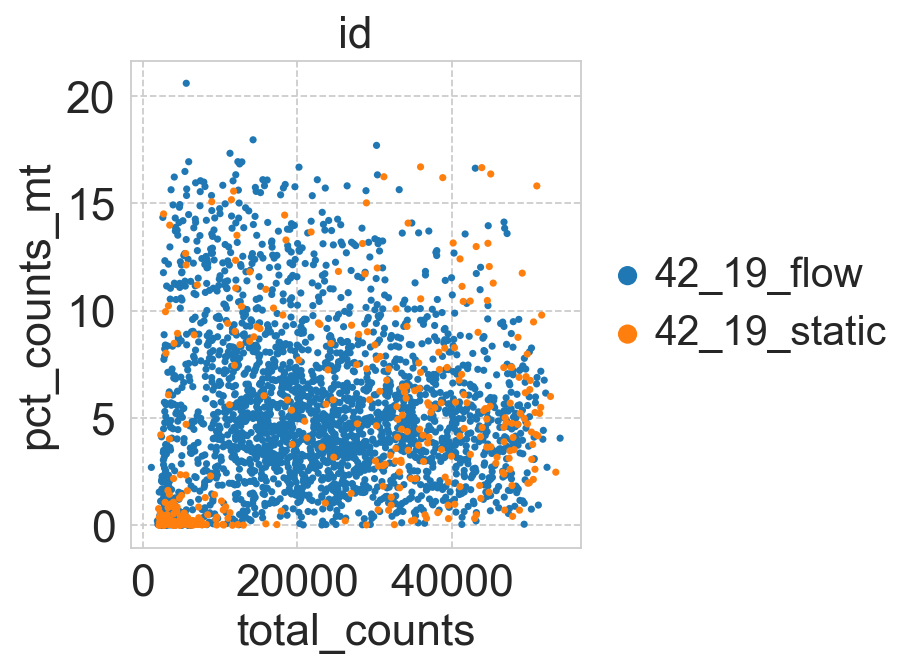

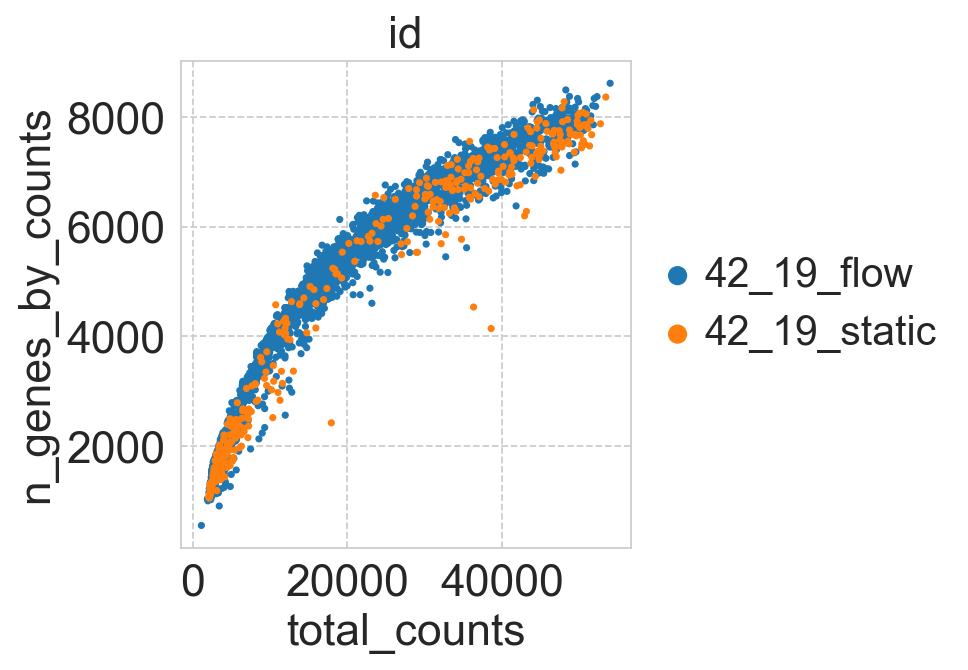

In [106]:
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt', color="id")
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts', color="id")

In [107]:
#normalize total counts 

sc.pp.normalize_total(adata, target_sum=10000)

In [108]:
sc.pp.log1p(adata)

In [109]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

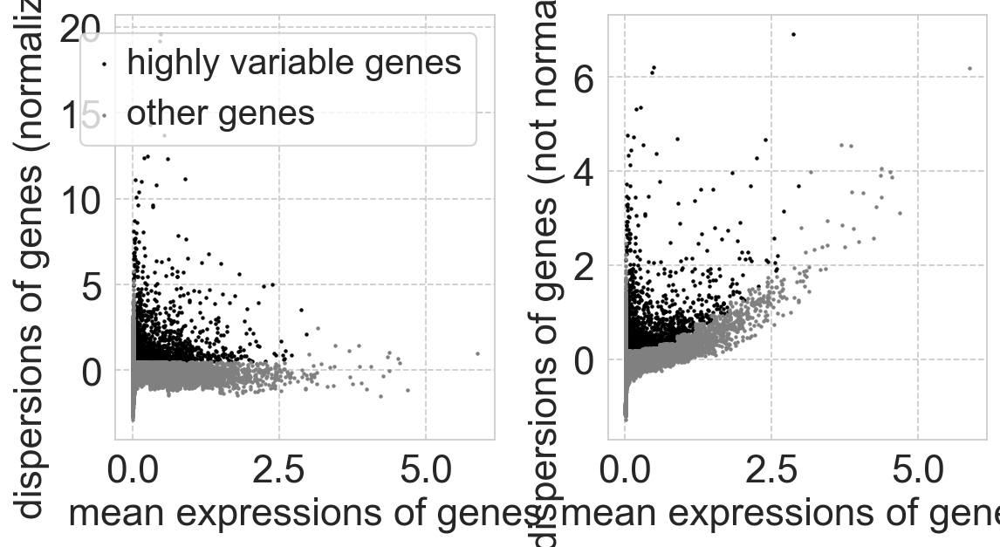

In [110]:
sc.pl.highly_variable_genes(adata)

In [111]:
#save adata.raw 

adata.raw=adata
adata = adata[:, adata.var.highly_variable].copy()

In [112]:
adata.var

,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,n_cells,highly_variable,means,dispersions,dispersions_norm
SAMD11,False,55,0.030261,98.086957,87.0,55,True,0.012957,0.243335,0.660756
HES4,False,2587,8.720000,10.017391,25070.0,2587,True,1.608800,1.071502,0.759689
ISG15,False,1479,1.082435,48.556522,3112.0,1479,True,0.426033,1.238372,3.711573
ACAP3,False,1229,0.654261,57.252174,1881.0,1229,True,0.285987,0.263665,0.707684
CCNL2,False,1805,1.410087,37.217391,4054.0,1805,True,0.575057,0.797838,2.307296
...,...,...,...,...,...,...,...,...,...,...
MT-ND2,True,2548,27.073391,11.373913,77836.0,2548,True,2.536143,2.570145,1.698487
MT-ATP8,True,1602,1.495304,44.278261,4299.0,1602,True,0.538868,0.670837,1.902462
MT-ND4L,True,2387,6.802783,16.973913,19558.0,2387,True,1.423458,1.371899,1.844257
MT-ND5,True,2485,15.061913,13.565217,43303.0,2485,True,2.053588,2.123808,2.140372


In [113]:
adata.raw.X

<2875x17802 sparse matrix of type '<class 'numpy.float32'>'
	with 14962434 stored elements in Compressed Sparse Row format>

In [114]:
adata.var.highly_variable.sum()

2212

# Cell cycle regression
List of cell cycle genes from GitHub scverse repository
https://github.com/scverse/scanpy_usage/blob/master/180209_cell_cycle/data/regev_lab_cell_cycle_genes.txt

Original publication:

Kowalczyk MS, Tirosh I, Heckl D, Rao TN, Dixit A, Haas BJ, Schneider RK, Wagers AJ, Ebert BL, Regev A. Single-cell RNA-seq reveals changes in cell cycle and differentiation programs upon aging of hematopoietic stem cells. Genome Res. 2015 Dec;25(12):1860-72. doi: 10.1101/gr.192237.115. Epub 2015 Oct 1. PMID: 26430063; PMCID: PMC4665007.

In [116]:
cell_cycle_genes = [x.strip() for x in open('./regev_lab_cell_cycle_genes.txt')]
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata.var_names]
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

In [117]:
#Regress out mitochondrial genes, cell cycle genes

sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt','S_score', 'G2M_score'])

In [118]:
adata

AnnData object with n_obs × n_vars = 2875 × 2212
    obs: 'id', 'doublet_scores', 'predicted_doublets', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes', 'S_score', 'G2M_score', 'phase'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'id_colors', 'log1p', 'hvg'

In [119]:
qc = pd.crosstab(adata.obs['pct_counts_mt'],adata.obs["id"], normalize='index')
qc

id,42_19_flow,42_19_static
pct_counts_mt,,
0.000000,0.583333,0.416667
0.008615,0.000000,1.000000
0.015357,0.000000,1.000000
0.015758,0.000000,1.000000
0.016499,0.000000,1.000000
...,...,...
16.936205,1.000000,0.000000
17.326601,1.000000,0.000000
17.694494,1.000000,0.000000


# PCA

C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\preprocessing\_normalization.py:197: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


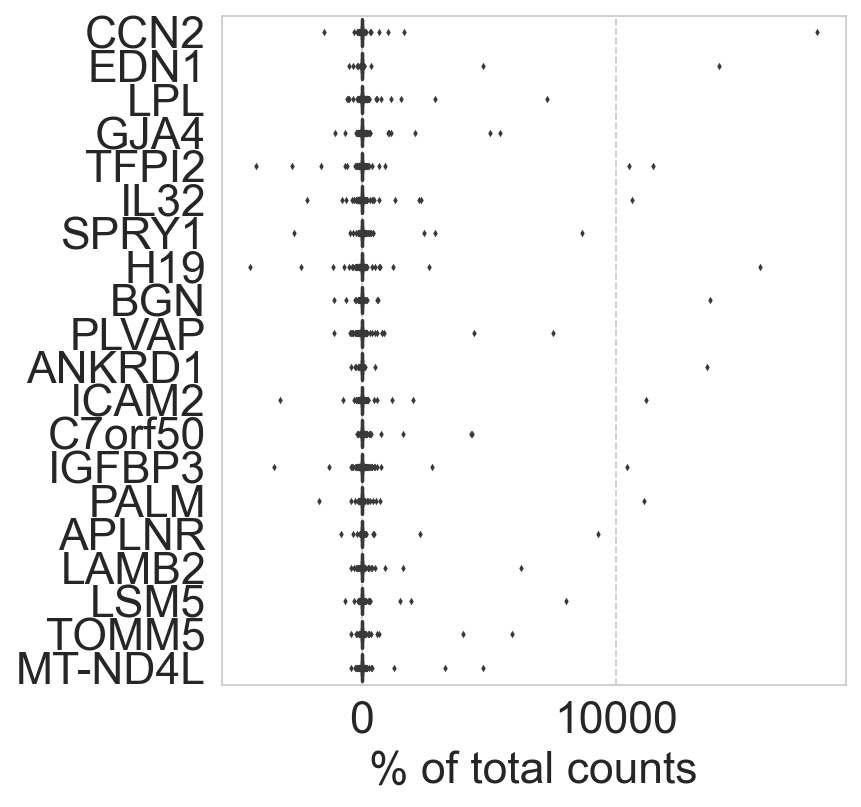

In [123]:
sc.pl.highest_expr_genes(adata, n_top=20)

In [67]:
sc.tl.pca(adata, svd_solver='arpack')

C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


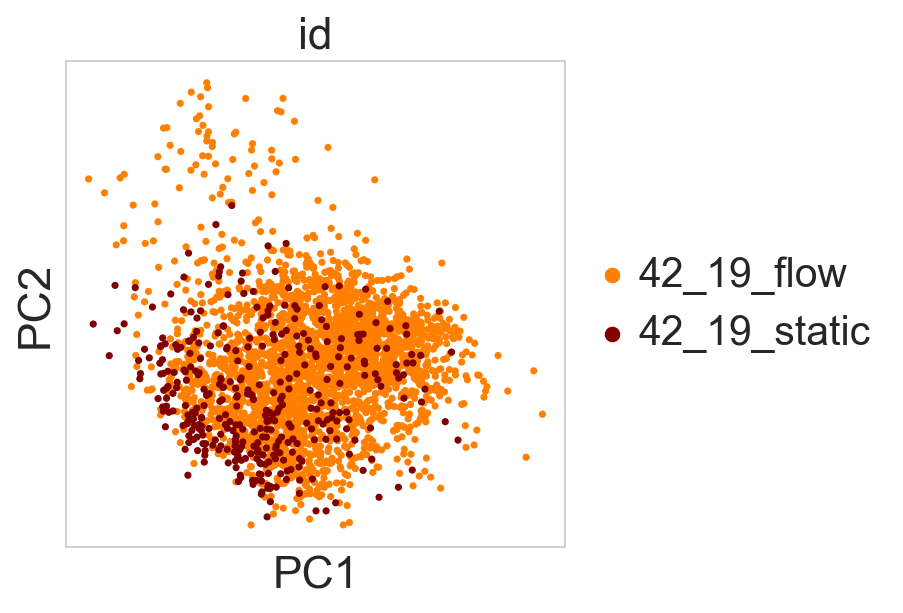

In [124]:
sc.pl.pca(adata, color='id')

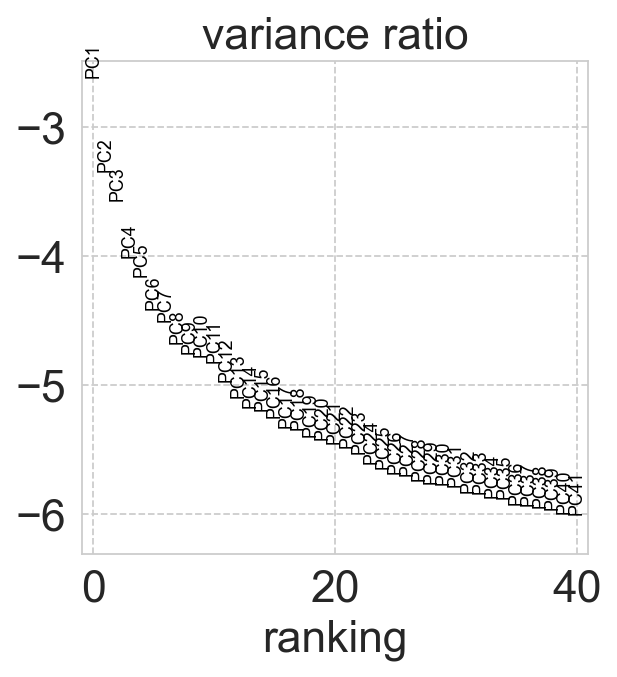

In [125]:
sc.pl.pca_variance_ratio(adata, log=True,n_pcs=40)

In [70]:
adata

In [126]:
adata.obs.id.value_counts()

id
42_19_flow      2511
42_19_static     364
Name: count, dtype: int64

In [73]:
sc.tl.umap(adata)

C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


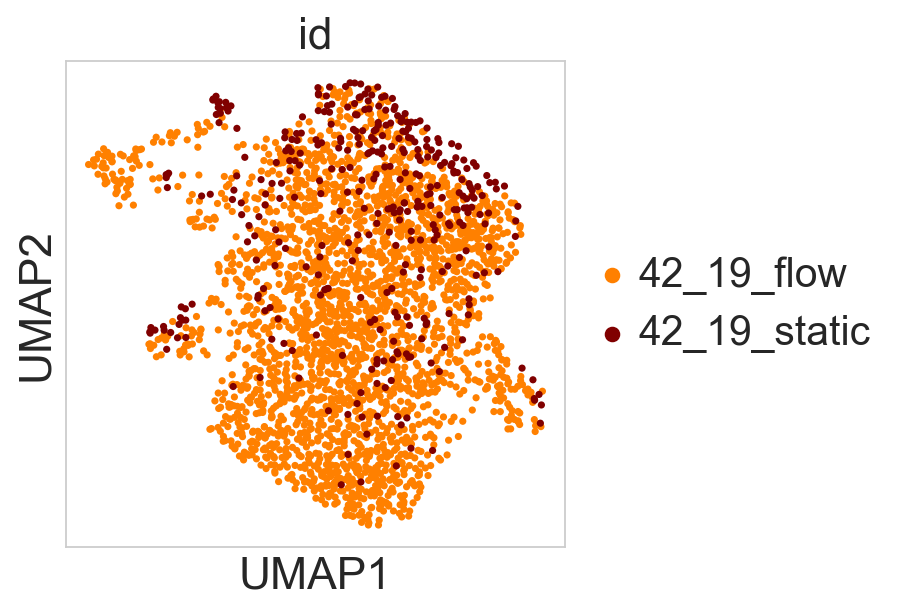

In [127]:
sc.pl.umap(adata, color=['id'], palette = color_cond)

### Save after preprocessing and filtering

In [76]:
#after_preprocessing_and_filtering = r"E:/"

In [77]:
#adata.write(after_preprocessing_and_filtering)

In [120]:
adata=sc.read_h5ad(r"E:\2_after_preprocessing_and_filtering.h5ad")

In [121]:
adata

AnnData object with n_obs × n_vars = 2875 × 2212
    obs: 'id', 'doublet_scores', 'predicted_doublets', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes', 'S_score', 'G2M_score', 'phase'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'id_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

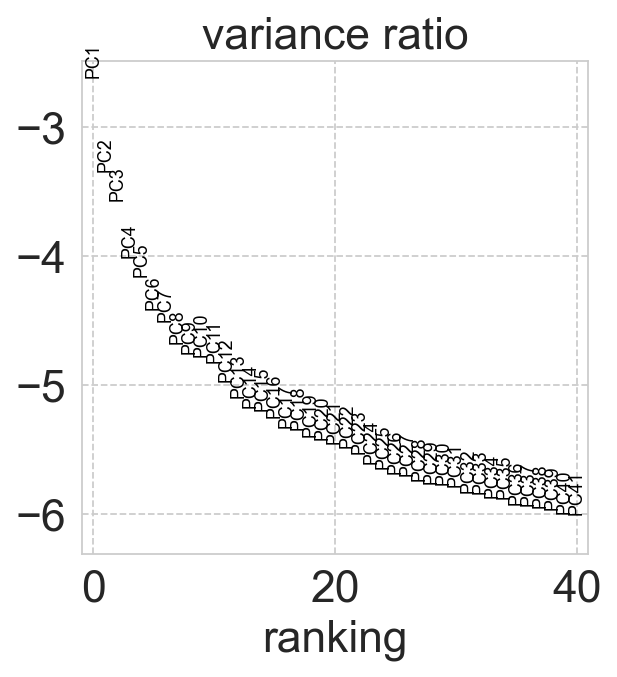

In [122]:
sc.pl.pca_variance_ratio(adata, log=True,n_pcs=40)

### Plot doublets

In [128]:
#rewrite column 'predicted doublets' from boolean to int
adata.obs['predicted_doublets']=adata.obs['predicted_doublets'].replace({True:1, False:0})

C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


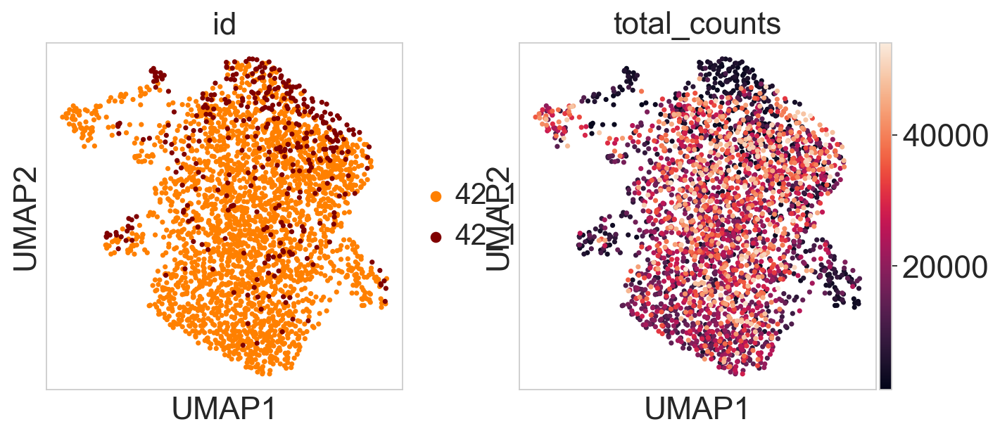

In [129]:
sc.pl.umap(adata, color=['id', 'total_counts'])

C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


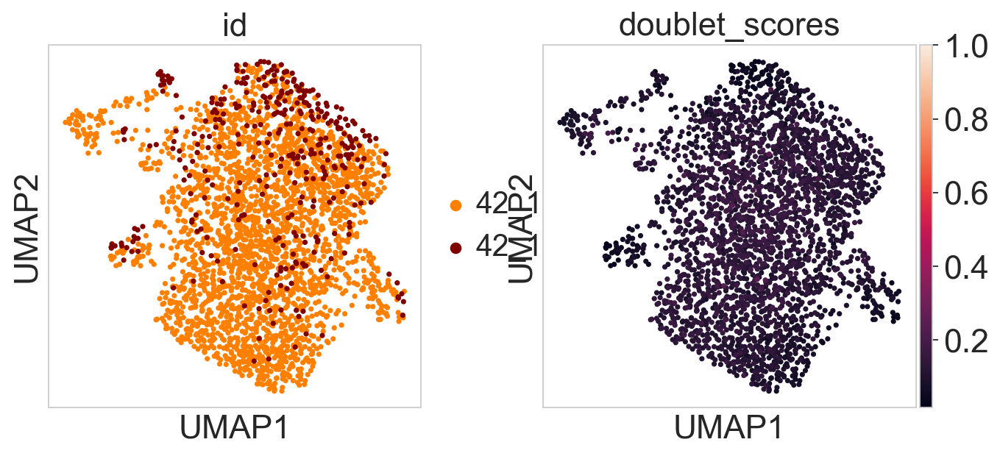

In [131]:
sc.pl.umap(adata, color = ("id", 'doublet_scores'),vmax = 1)

C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


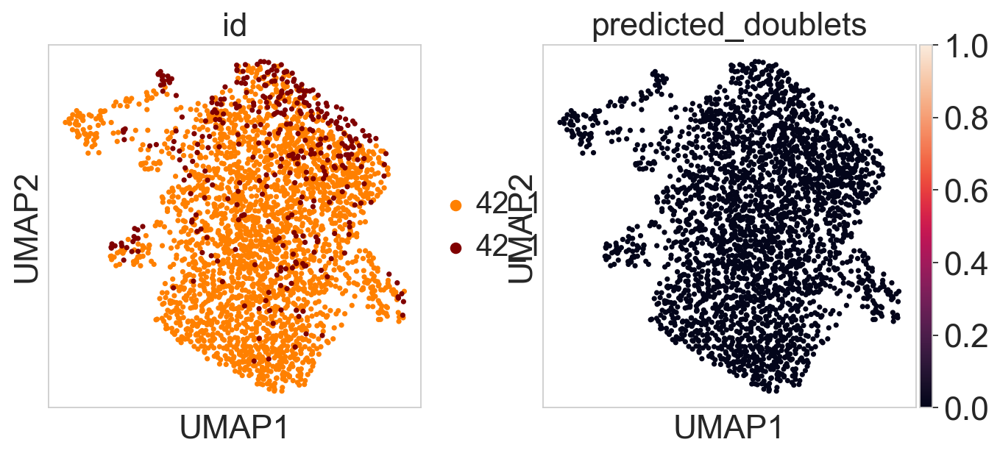

In [132]:
sc.pl.umap(adata, color = ("id", 'predicted_doublets'), vmax = 1)

# Leiden clustering

In [137]:
sc.tl.leiden(adata, resolution = 0.5, key_added="leiden")

C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


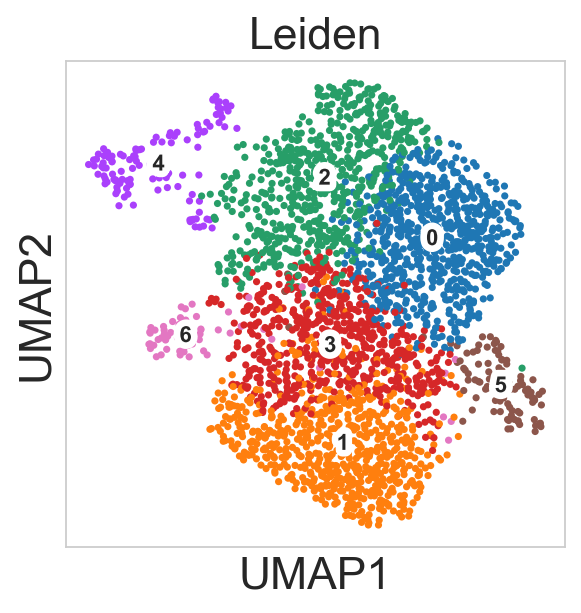

In [144]:
sc.pl.umap(adata, color=['leiden'],legend_loc='on data',
           legend_fontoutline=6,legend_fontsize=10, title='Leiden')

In [145]:
adata

AnnData object with n_obs × n_vars = 2875 × 2212
    obs: 'id', 'doublet_scores', 'predicted_doublets', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes', 'S_score', 'G2M_score', 'phase', 'leiden_1.0', 'leiden', 'cell type', 'Glycolysis / Gluconeogenesis', 'Citrate cycle (TCA cycle)', 'Pentose phosphate pathway', 'Pentose and glucuronate interconversions', 'Fructose and mannose metabolism', 'Galactose metabolism', 'Ascorbate and aldarate metabolism', 'Fatty acid biosynthesis', 'Fatty acid elongation', 'Fatty acid degradation', 'Synthesis and degradation of ketone bodies', 'Steroid biosynthesis', 'Primary bile acid biosynthesis', 'Ubiquinone and other terpenoid-quinone biosynthesis', 'Steroid hormone biosynthesis', 'Oxidative phosphorylation', 'Arginine biosynthesis', 'Purine metabolism', 'Caffeine metabolism', 'Pyrimidine metabolism', 'Alanine, aspartate and glutamate metabolism', 'Glycine, serine and threonine metabolism', 'Cysteine and met

C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


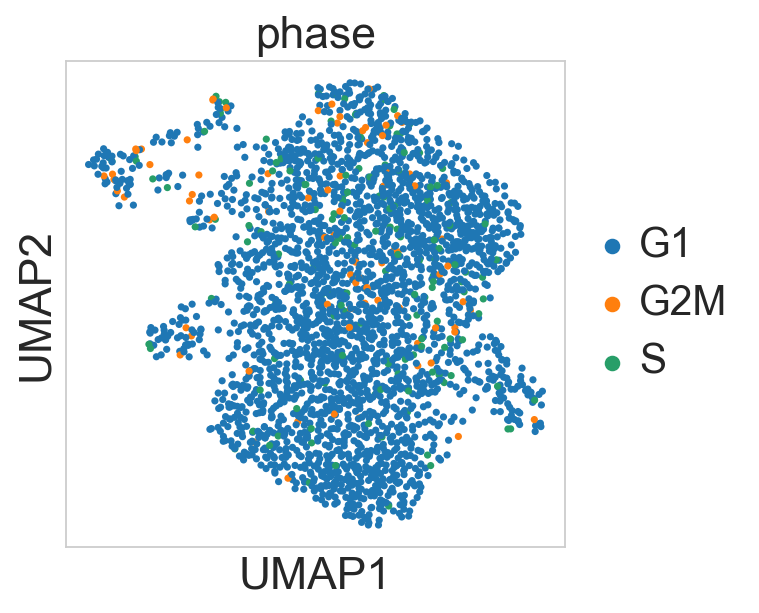

In [146]:
sc.pl.umap(adata, color=["phase"])

C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


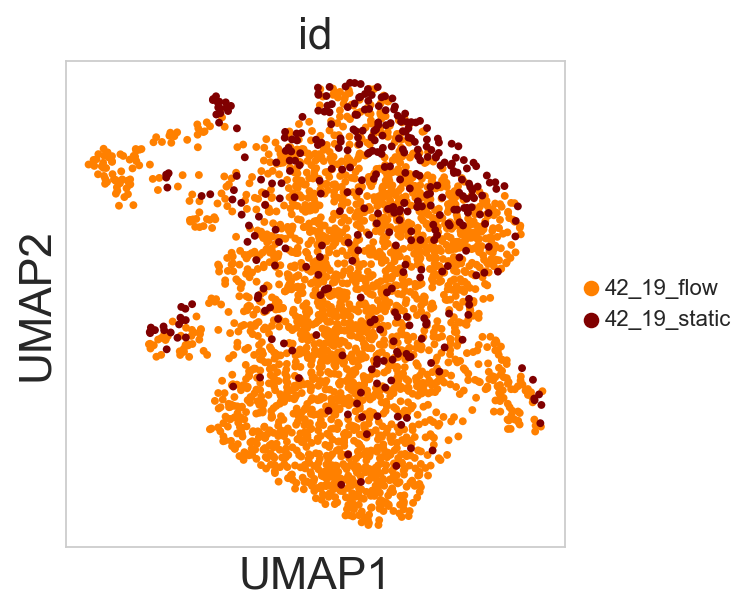

In [147]:
#save umap
sc.pl.umap(adata, color=["id"],size=50, use_raw=False, legend_fontoutline=6,legend_fontsize=10, title='id')

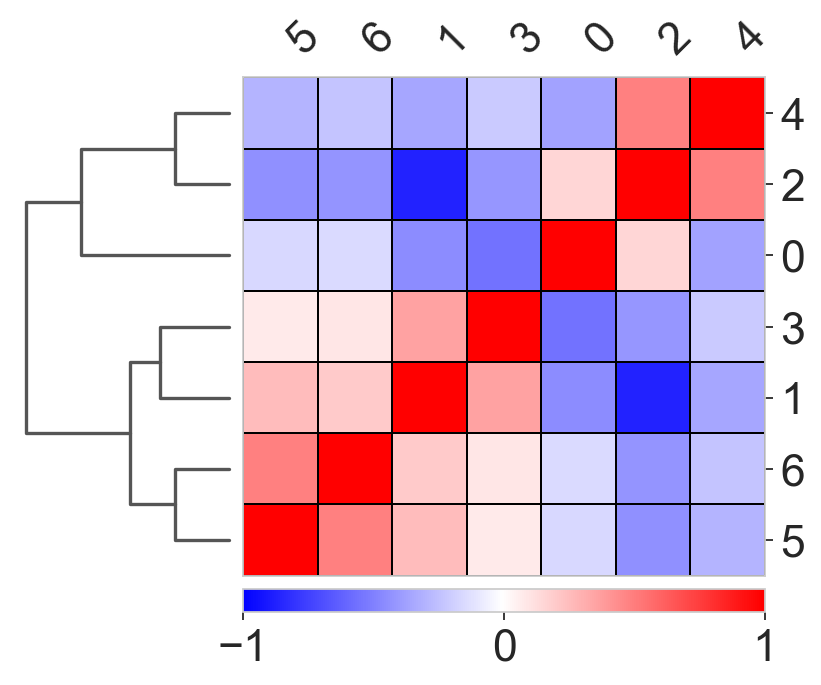

In [148]:
sc.tl.dendrogram(adata, 'leiden', n_pcs=28)
sc.pl.correlation_matrix(adata, 'leiden')

# Definition of cell types

In [155]:
cell_type_colors=['#3288bd','#d35f5f', '#66c2a5', '#a02c2c','#225500','#440055', '#440055']

#colors =  barrier, flow, intermediate, mural, static ,stress,filopdia 1,filopdia 2
sns.color_palette(cell_type_colors)

[(0.19607843137254902, 0.5333333333333333, 0.7411764705882353),
 (0.8274509803921568, 0.37254901960784315, 0.37254901960784315),
 (0.4, 0.7607843137254902, 0.6470588235294118),
 (0.6274509803921569, 0.17254901960784313, 0.17254901960784313),
 (0.13333333333333333, 0.3333333333333333, 0.0),
 (0.26666666666666666, 0.0, 0.3333333333333333),
 (0.26666666666666666, 0.0, 0.3333333333333333)]

In [32]:
# annotate clusters to defined cell types by using matrixplot plotting marker_genes_dict for the single clusters
# but also using the correlation plot and  the cluster-showing UMAP to define which clusters are related to each other 

#rename clusters 
cluster2annotation = {
     '0': 'barrier',
     '1': 'flow',
     '2': 'static',
     '3': 'intermediate',
     '4': 'mural cell-like',
     '5': 'filopodia-like-1',
     '6': 'filopodia-like-2',
    
}

# add a new `.obs` column called `cell type` by mapping clusters to annotation using pandas `map` function
adata.obs['cell type'] = adata.obs['leiden'].map(cluster2annotation).astype('category')
adata


AnnData object with n_obs × n_vars = 2875 × 2212
    obs: 'id', 'doublet_scores', 'predicted_doublets', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes', 'S_score', 'G2M_score', 'phase', 'leiden_1.0', 'leiden', 'cell type'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'id_colors', 'neighbors', 'pca', 'umap', 'leiden', 'leiden_1.0_colors', 'leiden_colors', 'dendrogram_leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

#### UMAPs per cell type

C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


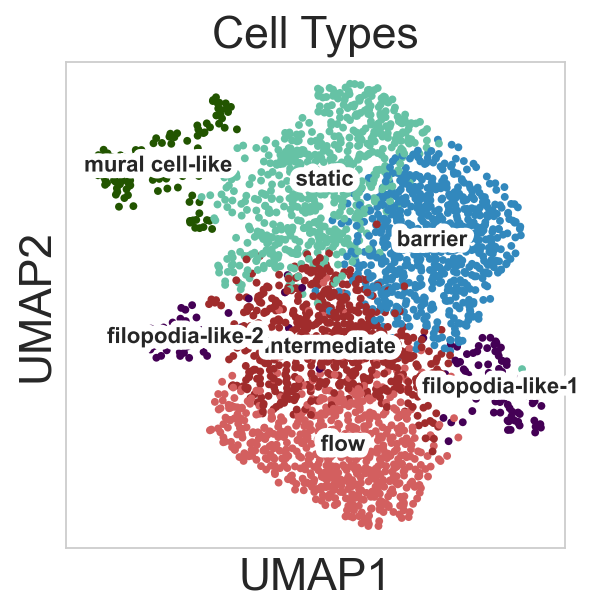

In [156]:
sc.pl.umap(adata, color=['cell type'],size=50, use_raw=False, palette=cell_type_colors, legend_loc='on data',
           legend_fontoutline=6,legend_fontsize=10, title='Cell Types')


# Finding marker genes
compute a ranking for the highly differential genes in each cluster
outgoing from these gene rankings we identified cluster-specific markers that could be aligned to specific EC functions/phenotypes and from markers known in literature

### Rank genes per t-test for defined cell types 

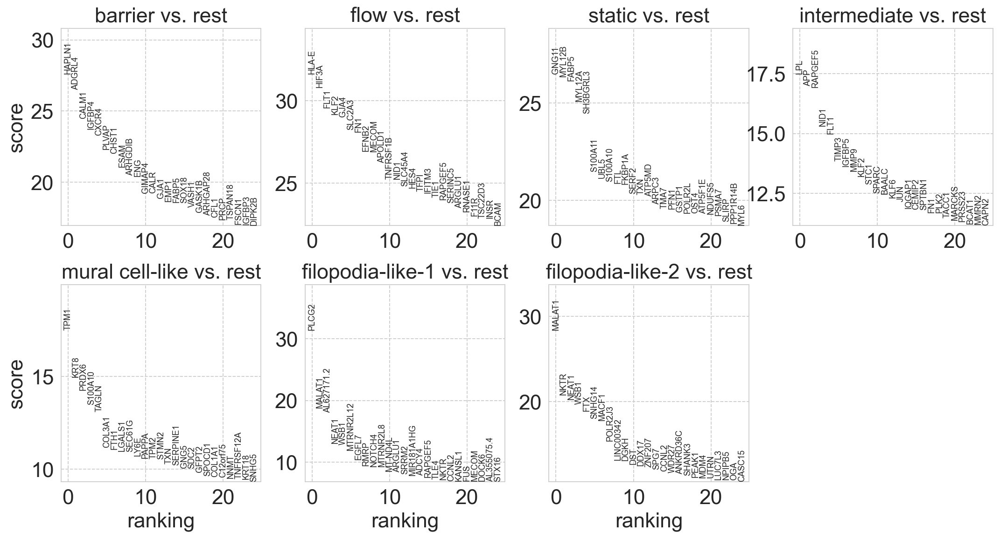

In [157]:
sc.tl.rank_genes_groups(adata, 'cell type', method='t-test')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)


pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(200)
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names

t_test_ranks  = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals']}).head(200)
#t_test_ranks.to_csv("t-test_celltype.csv")

# save adata and don´t change for downstream analysis

In [159]:
#adata_cluster_annotation = r"/E:/3_cluster_annotation.h5ad"

In [160]:
#adata.write(adata_cluster_annotation)

#### write version with only flow cells  or static cells for velocity analysis

In [34]:
adata_static = adata[adata.obs.id == "42_19_static"] 
adata_static

View of AnnData object with n_obs × n_vars = 364 × 2212
    obs: 'id', 'doublet_scores', 'predicted_doublets', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes', 'S_score', 'G2M_score', 'phase', 'leiden_1.0', 'leiden', 'cell type'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'id_colors', 'neighbors', 'pca', 'umap', 'leiden', 'leiden_1.0_colors', 'leiden_colors', 'phase_colors', 'dendrogram_leiden', 'rank_genes_groups', 'wilcoxon', 'cell type_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [35]:
adata_static_velocity = "E:/velocity_version_static.h5ad"

In [36]:
adata_static.write(adata_static_velocity)

In [37]:
adata_flow = adata[adata.obs.id == "42_19_flow"] 
adata_flow

View of AnnData object with n_obs × n_vars = 2511 × 2212
    obs: 'id', 'doublet_scores', 'predicted_doublets', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes', 'S_score', 'G2M_score', 'phase', 'leiden_1.0', 'leiden', 'cell type'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'id_colors', 'neighbors', 'pca', 'umap', 'leiden', 'leiden_1.0_colors', 'leiden_colors', 'phase_colors', 'dendrogram_leiden', 'rank_genes_groups', 'wilcoxon', 'cell type_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [38]:
adata_flow_velocity = r"E:\velocity_version_flow.h5ad"

In [39]:
adata_flow.write(adata_flow_velocity)

## Read adata with final cluster annotation

In [5]:
adata=sc.read_h5ad(r"E:\3_cluster_annotation.h5ad")

In [6]:
adata

AnnData object with n_obs × n_vars = 2875 × 2212
    obs: 'id', 'doublet_scores', 'predicted_doublets', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes', 'S_score', 'G2M_score', 'phase', 'leiden_1.0', 'leiden', 'cell type', 'Glycolysis / Gluconeogenesis', 'Citrate cycle (TCA cycle)', 'Pentose phosphate pathway', 'Pentose and glucuronate interconversions', 'Fructose and mannose metabolism', 'Galactose metabolism', 'Ascorbate and aldarate metabolism', 'Fatty acid biosynthesis', 'Fatty acid elongation', 'Fatty acid degradation', 'Synthesis and degradation of ketone bodies', 'Steroid biosynthesis', 'Primary bile acid biosynthesis', 'Ubiquinone and other terpenoid-quinone biosynthesis', 'Steroid hormone biosynthesis', 'Oxidative phosphorylation', 'Arginine biosynthesis', 'Purine metabolism', 'Caffeine metabolism', 'Pyrimidine metabolism', 'Alanine, aspartate and glutamate metabolism', 'Glycine, serine and threonine metabolism', 'Cysteine and met

In [7]:
cell_type_colors=['#3288bd','#d35f5f', '#66c2a5', '#a02c2c','#225500','#440055', '#440055']
#colors =  barrier, filopdia, flow, intermediate, mural, static ,stress

sns.color_palette(cell_type_colors)
#sns.reset_defaults()

[(0.19607843137254902, 0.5333333333333333, 0.7411764705882353),
 (0.8274509803921568, 0.37254901960784315, 0.37254901960784315),
 (0.4, 0.7607843137254902, 0.6470588235294118),
 (0.6274509803921569, 0.17254901960784313, 0.17254901960784313),
 (0.13333333333333333, 0.3333333333333333, 0.0),
 (0.26666666666666666, 0.0, 0.3333333333333333),
 (0.26666666666666666, 0.0, 0.3333333333333333)]

In [8]:
adata.obs.id

AAACCCAAGTATGACA-1        42_19_flow
AAACCCAGTTGGAGAC-1        42_19_flow
AAACGAAAGGCGACAT-1        42_19_flow
AAACGAACAATTTCTC-1        42_19_flow
AAACGCTAGTGAGTTA-1        42_19_flow
                            ...     
TTTAGTCTCCCAAGCG-1      42_19_static
TTTCACAGTGTCTTCC-1-1    42_19_static
TTTCAGTCAATCGCCG-1      42_19_static
TTTCCTCCAGAGTGTG-1      42_19_static
TTTGGAGTCTGGCCAG-1-1    42_19_static
Name: id, Length: 2875, dtype: category
Categories (2, object): ['42_19_flow', '42_19_static']

C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


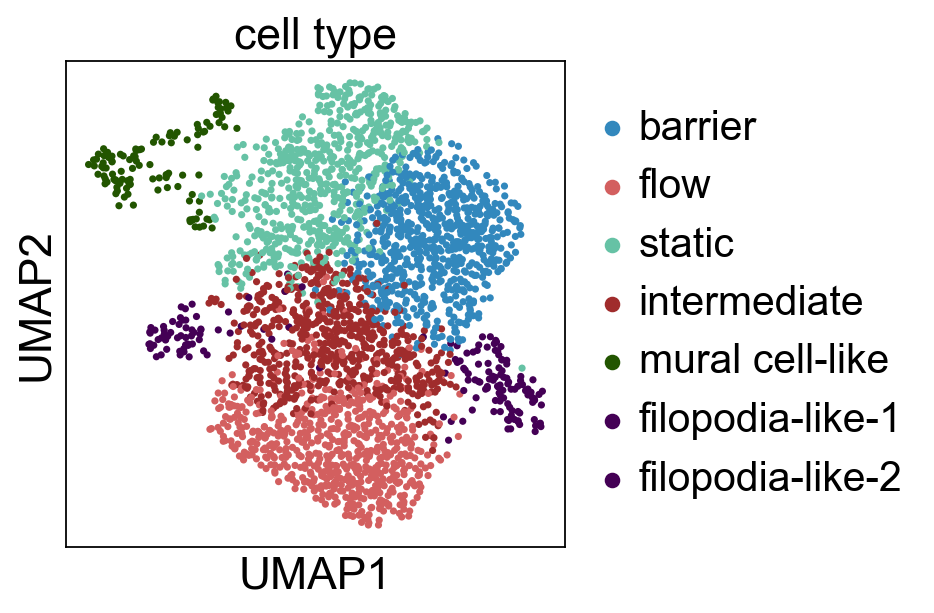

In [9]:
sc.pl.umap(adata, color="cell type")

# getting UMAPS for different clusters

In [10]:
#plot all genes from marker_genes_dict
marker_genes_dict = {

  'intermediate': ['JUN','AKAP12', 'PMP22','KTN1','MMP9','CDH13','ITGA2','THBD','TIMP2'],
    'filopodia-like-1': ["NOTCH4", "NOTCH1",'THBS1', 'FLNB', 'PLEC', "DOCK9", "DOCK4", "ARHGAP29", "NRP1" ],
    'filopodia-like-2' : ["MAML3", "NCOR2", "DVL3", "TGFB1"],
    'flow': ['KLF2', 'KLF4', 'FLT1', 'F11R', 'VWF','CYP1B1','NOS3',"DLL4",],
    'barrier': ['CLDN5', 'ENG', 'GJA1', 'SOX18', 'CDH5',"HEY1", "HES1"],
    'mural cell-like': [ "PDGFRB", "CSPG4", "TAGLN"],
    'static':  ['APLN', 'APLNR',"EDN1", "ANGPT2", "RALA",'HEBP2', 'S100A13', 'ROMO1', 'NQO1'],
    }

<!-- #here differentiate!
for final paper figure setting: use_raw = False 
but to show all markers of a cell type: use_raw = True  -->

In [11]:
sns.set_palette("magma")

#### mural celll ike 

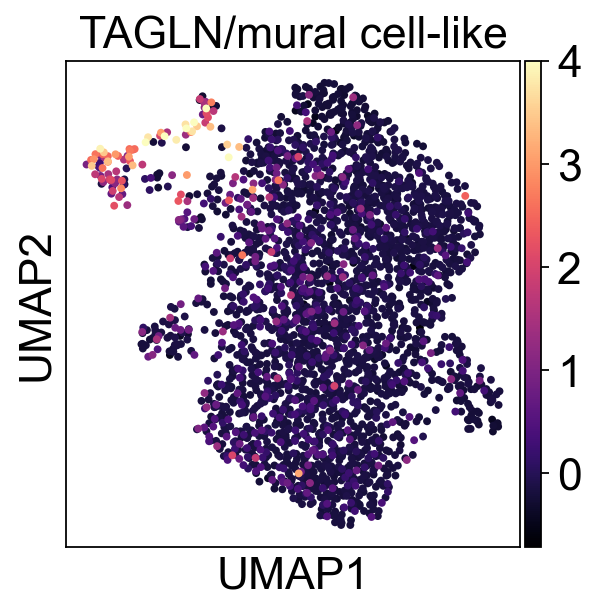

In [15]:
sc.pl.umap(adata, color=['TAGLN'],size=50, use_raw=False, legend_loc='on data',palette="magma",color_map=plt.cm.magma,
           legend_fontoutline=6,legend_fontsize=10,vmax=4, title="TAGLN/mural cell-like",save="UMAP_mural_TAGLN.svg")

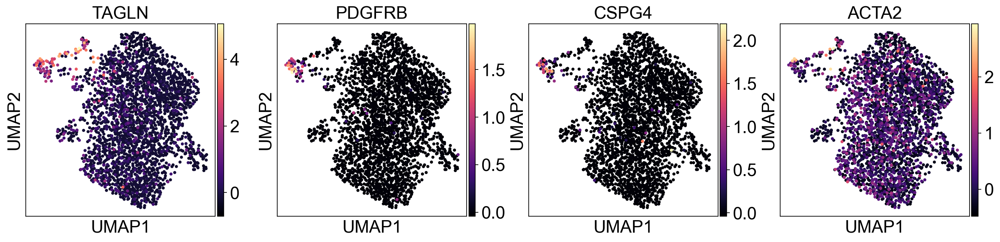

In [13]:
sc.pl.umap(adata, color=['TAGLN','PDGFRB',"CSPG4", "ACTA2" ],size=50, use_raw=False, palette="magma", legend_loc='on data',
           legend_fontoutline=6,legend_fontsize=10,color_map=plt.cm.magma,
           
          )


#### static

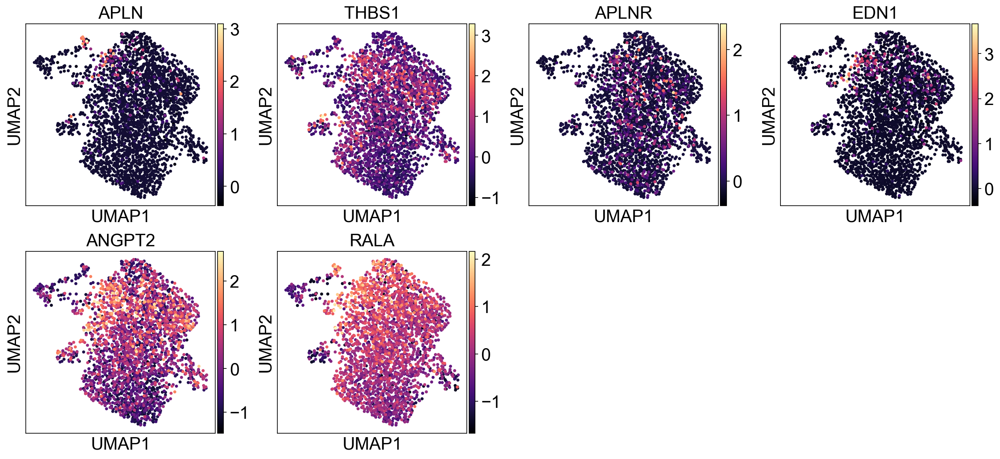

In [14]:
sc.pl.umap(adata, color=['APLN','THBS1', 'APLNR',"EDN1", "ANGPT2", "RALA"], size=50, use_raw=False, palette="viridis", legend_loc='on data',
           legend_fontoutline=6,legend_fontsize=10,color_map=plt.cm.magma,
           )

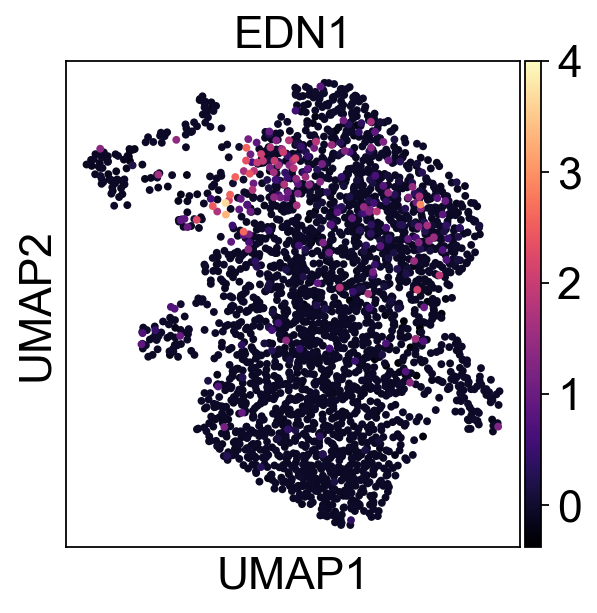

In [17]:
sc.pl.umap(adata, color=[ "EDN1"],size=50, use_raw=False, legend_loc='on data',palette="magma",
           legend_fontoutline=6,legend_fontsize=10,color_map=plt.cm.magma,vmax=4,save="UMAP_static_EDN1.svg"
          
          )

#### stress

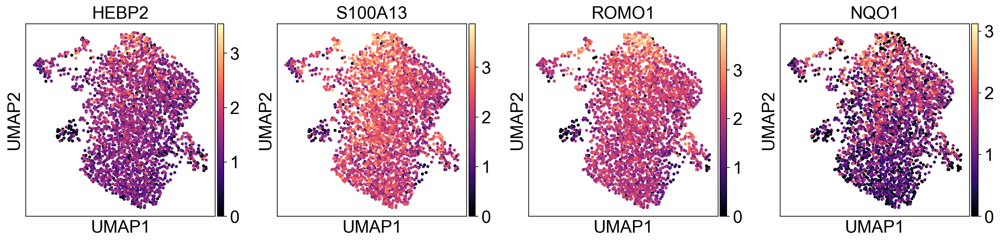

In [18]:
sc.pl.umap(adata, color=['HEBP2', 'S100A13', 'ROMO1', 'NQO1'] ,size=50, use_raw=True, legend_loc='on data',
           legend_fontoutline=6,legend_fontsize=10,color_map=plt.cm.magma,
           )

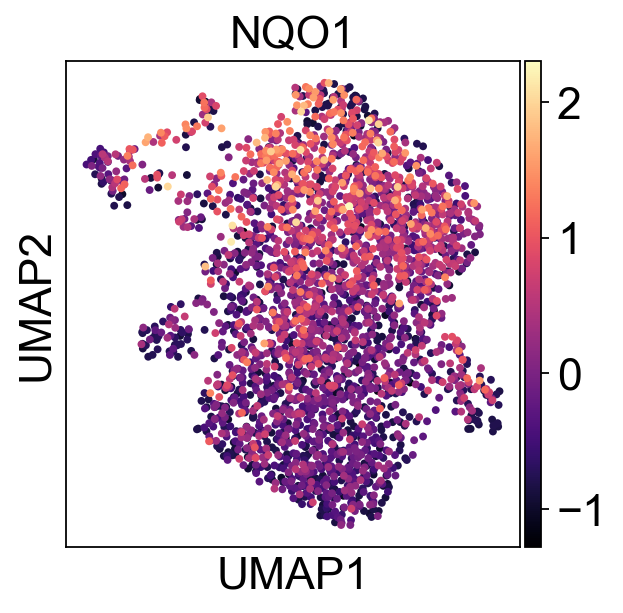

In [19]:
sc.pl.umap(adata, color=[ 'NQO1'],size=50, use_raw=False, legend_loc='on data',palette="magma",
           legend_fontoutline=6,legend_fontsize=10,color_map=plt.cm.magma,
           
          )


#### barrier#### 

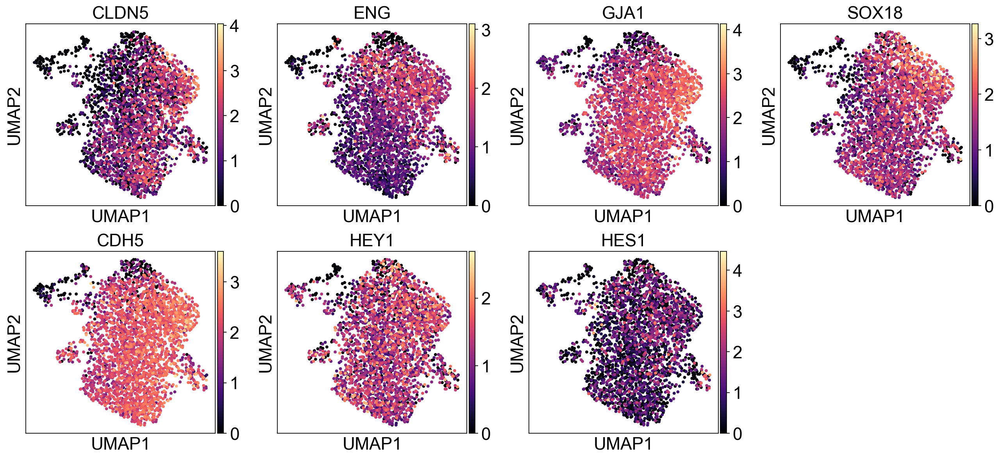

In [20]:
sc.pl.umap(adata, color=['CLDN5', 'ENG', 'GJA1', 'SOX18', 'CDH5',"HEY1", "HES1"],size=50, use_raw=True, legend_loc='on data',
           legend_fontoutline=6,legend_fontsize=10,color_map=plt.cm.magma,
         
          )

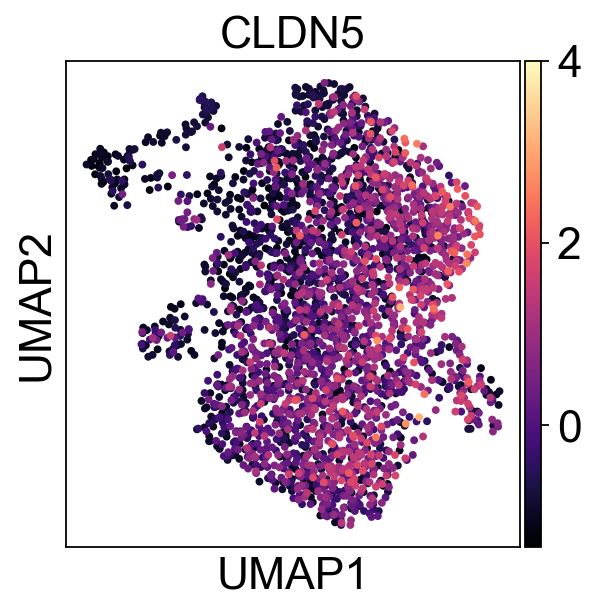

In [21]:
sc.pl.umap(adata, color=['CLDN5'],size=50, use_raw=False, legend_loc='on data',palette="magma",
           legend_fontoutline=6,legend_fontsize=10,color_map=plt.cm.magma,vmax=4, save="UMAP_barrier_CLDN5.svg"
          )

#### filopodia-like -1 

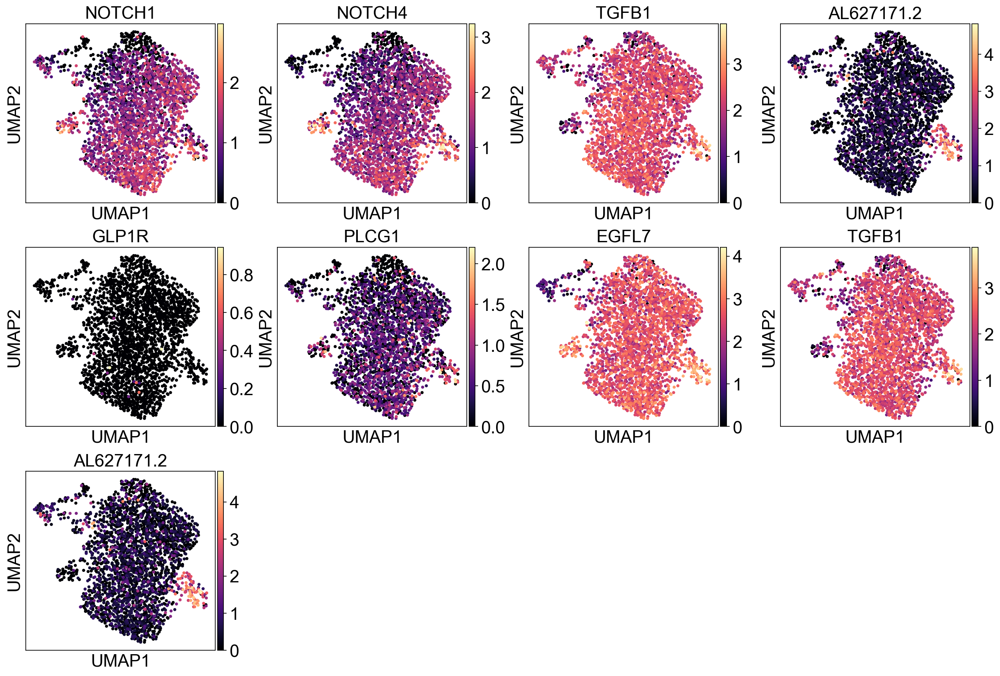

In [22]:
sc.pl.umap(adata, color= ["NOTCH1", "NOTCH4", 
                          "TGFB1", 
                          "AL627171.2", 
                          "GLP1R", 
                          "PLCG1", 
                          "EGFL7",
                          "TGFB1",
                          "AL627171.2" 
                         ],size=50, use_raw=True, palette="magma", legend_loc='on data',color_map=plt.cm.magma,
                      
           legend_fontoutline=6,legend_fontsize=10,
    
          )

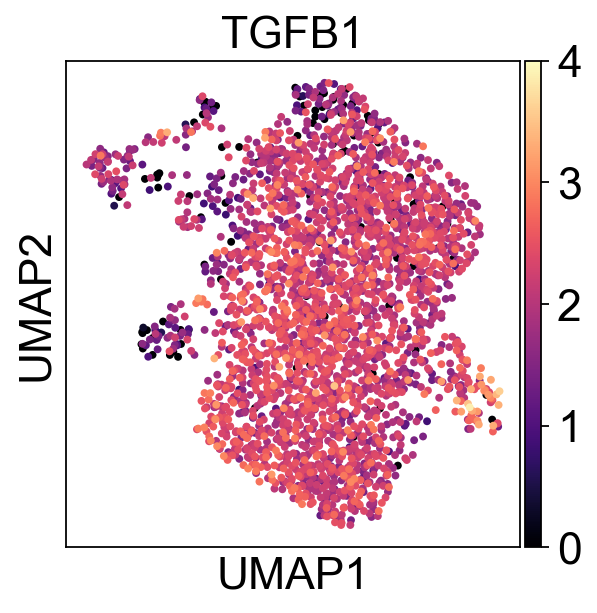

In [23]:
sc.pl.umap(adata, color= [ "TGFB1"],size=50, use_raw=True, palette="viridis", legend_loc='on data',
           legend_fontoutline=6,legend_fontsize=10, color_map=plt.cm.magma,vmax=4,save="UMAP_filo1_TGFB1.svg"
           
          )

### filopodia-like -2

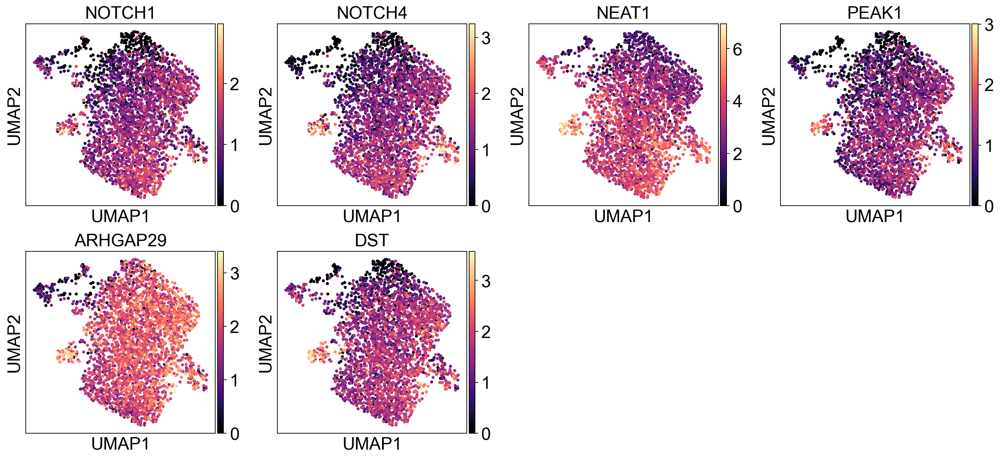

In [24]:
sc.pl.umap(adata, color= ["NOTCH1", "NOTCH4",
                          "NEAT1" , 
                          "PEAK1", 
                          "ARHGAP29",
                         "DST", 
                         ],size=50, use_raw=True, palette="magma", legend_loc='on data',
           legend_fontoutline=6,legend_fontsize=10,color_map=plt.cm.magma,
          )

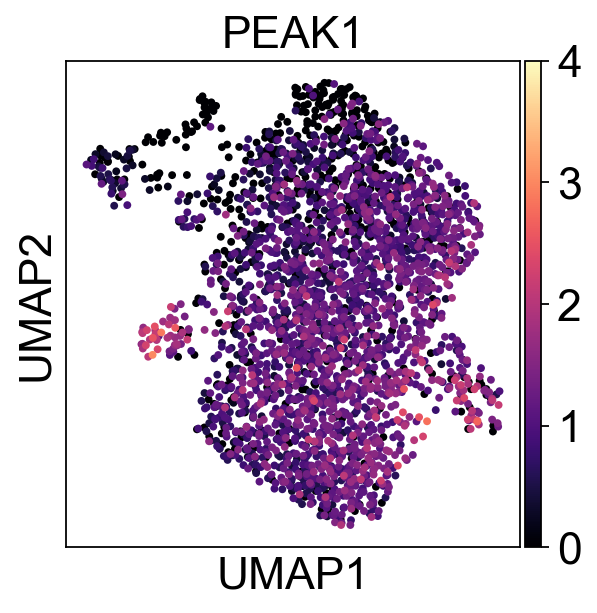

In [25]:
sc.pl.umap(adata, color= ["PEAK1"],size=50, use_raw=True, palette="magma", legend_loc='on data',color_map=plt.cm.magma,
           legend_fontoutline=6,legend_fontsize=10,vmax=4,save="UMAP_filo2_PEAK1.svg"
          )

#### flow

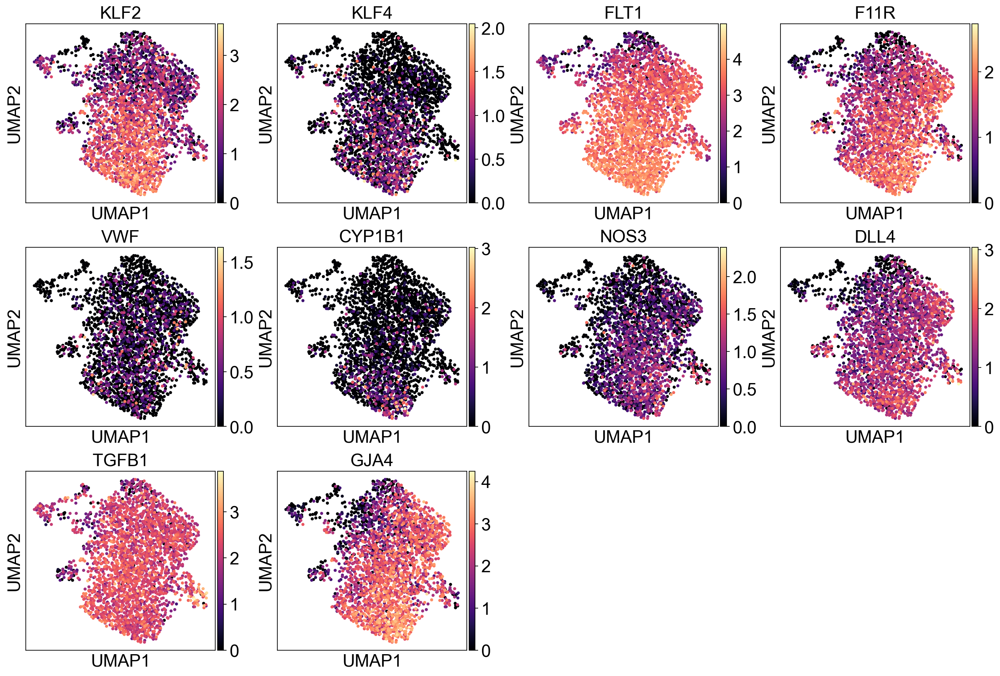

In [26]:
sc.pl.umap(adata, color=['KLF2', 'KLF4', 'FLT1', 'F11R', 'VWF','CYP1B1','NOS3',"DLL4",'TGFB1', "GJA4"],size=50, use_raw=True, color_map="magma", legend_loc='on data',
           legend_fontoutline=6,legend_fontsize=10, 
          )

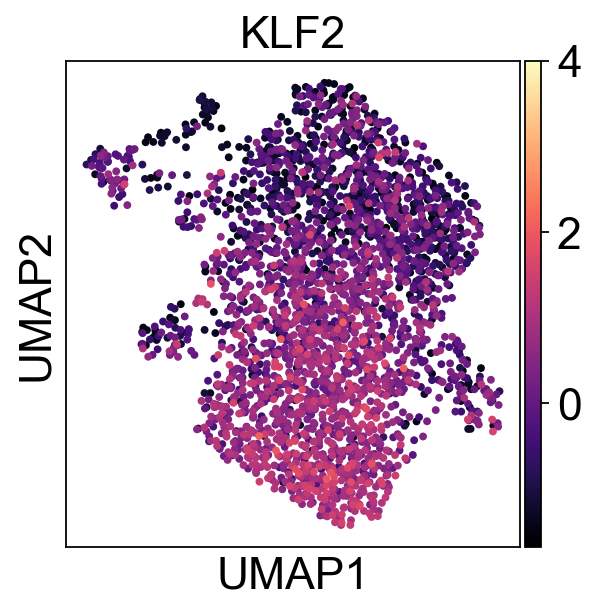

In [27]:
sc.pl.umap(adata, color=[ 'KLF2' ],size=50, use_raw=False, palette="magma", legend_loc='on data', color_map=plt.cm.magma,
           legend_fontoutline=6,legend_fontsize=10,vmax=4,save="UMAP_flow_KLF2.svg"
          )


#### Intermediate

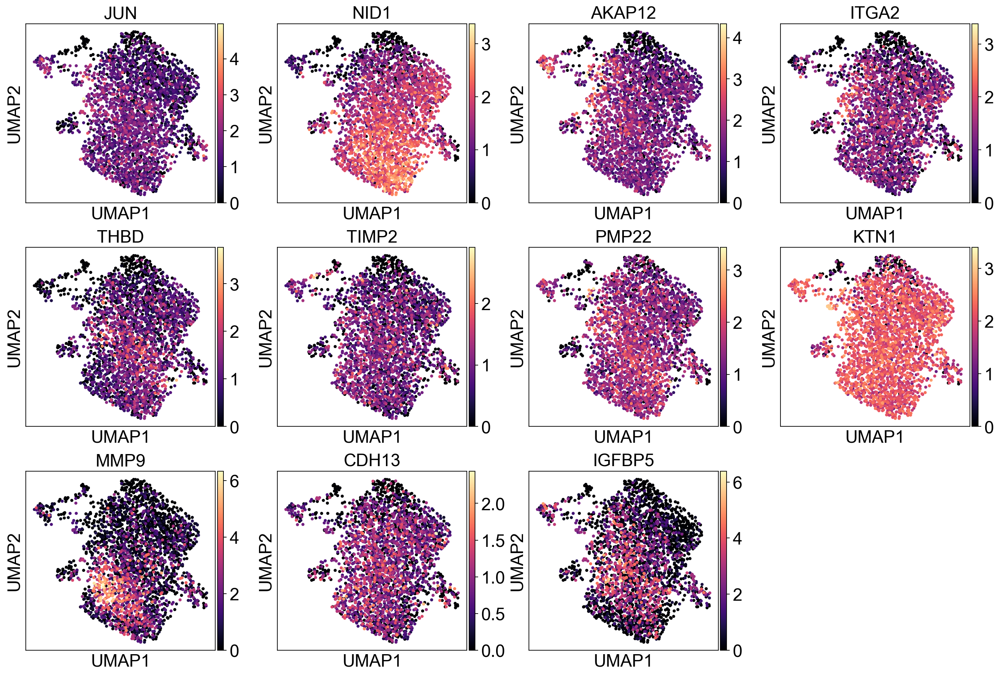

In [28]:
sc.pl.umap(adata, color=['JUN', "NID1",
'AKAP12','ITGA2','THBD','TIMP2','PMP22','KTN1','MMP9','CDH13', "IGFBP5"],size=50, use_raw=True, color_map="magma", legend_loc='on data',
           legend_fontoutline=6,legend_fontsize=10,
          )

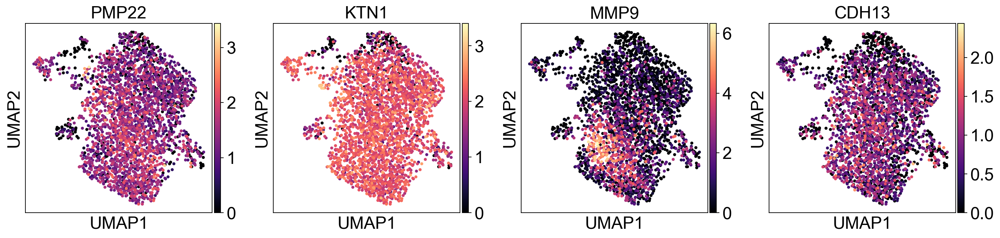

In [29]:
sc.pl.umap(adata, color=['PMP22','KTN1','MMP9','CDH13'],size=50, use_raw=True, color_map="magma", legend_loc='on data',
           legend_fontoutline=6,legend_fontsize=10)

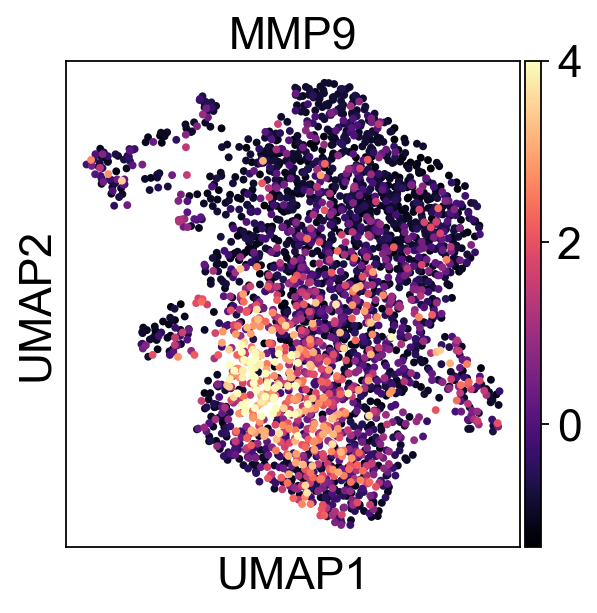

In [30]:
sc.pl.umap(adata, color=['MMP9'],size=50, use_raw=False, palette="magma", legend_loc='on data', color_map=plt.cm.magma,
           legend_fontoutline=6,legend_fontsize=10,vmax=4,save="UMAP_intermediate_MMP9.svg"

          )


C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


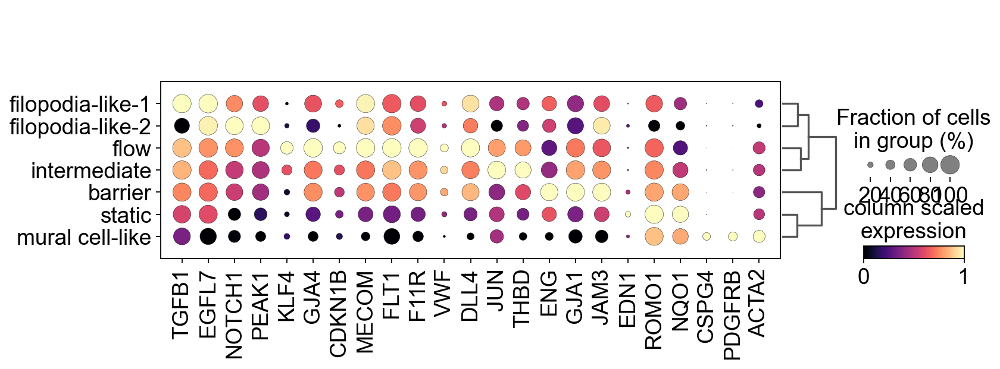

In [32]:
marker_celltype = ["TGFB1","EGFL7",#filopodia 1
                   "NOTCH1","PEAK1", #filopodia 2
                   "KLF4", "GJA4",  "CDKN1B", "MECOM","FLT1", "F11R","VWF", "DLL4", # flow
                   "JUN", "THBD", #intermediate
                    "ENG","GJA1","JAM3", #barrier
                   "EDN1", "ROMO1","NQO1",#static+ stress marker
                   "CSPG4","PDGFRB","ACTA2" #mural-like      
                   
                  ]
sc.pl.dotplot(adata, marker_celltype, groupby='cell type', dendrogram=True, cmap='magma', standard_scale='var', colorbar_title='column scaled\nexpression')

### Further plots of gene expression analysis

C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


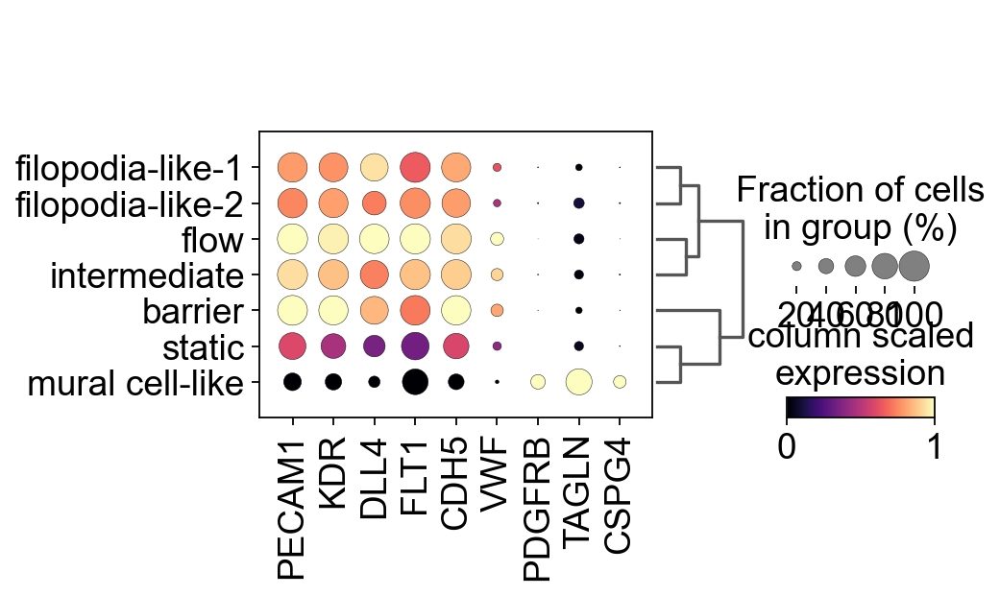

In [33]:
#EC vs mural-like cells
EC_genes = ['PECAM1', 'KDR', 'DLL4','FLT1',  "CDH5", "VWF",#EC genes
           "PDGFRB", 'TAGLN', "CSPG4"] # mural genes

sc.pl.dotplot(adata, EC_genes, groupby='cell type', dendrogram=True, cmap='magma', standard_scale='var', colorbar_title='column scaled\nexpression')

C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


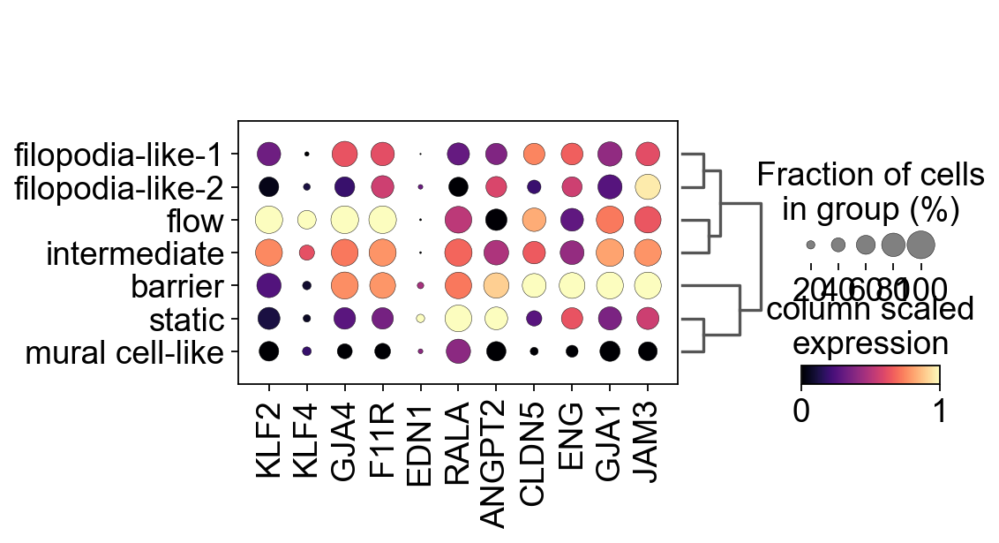

In [34]:
#flow vs static vs barrier

flow_static = ['KLF2', 'KLF4', 'GJA4','F11R', #flow genes
               "EDN1", "RALA","ANGPT2", #static genes
               "CLDN5", "ENG","GJA1", "JAM3"  ] #barrier genes
sc.pl.dotplot(adata,flow_static , groupby='cell type', dendrogram=True, cmap='magma', standard_scale='var', colorbar_title='column scaled\nexpression')


C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


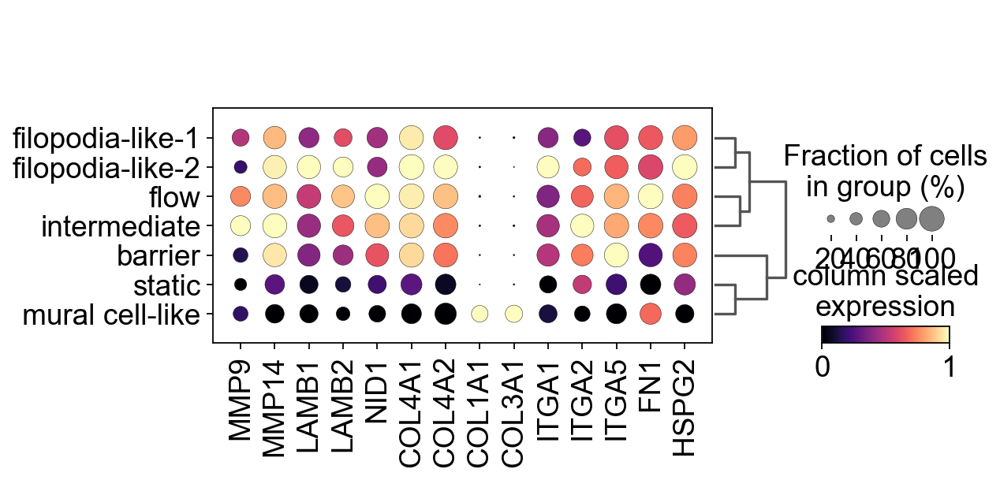

C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


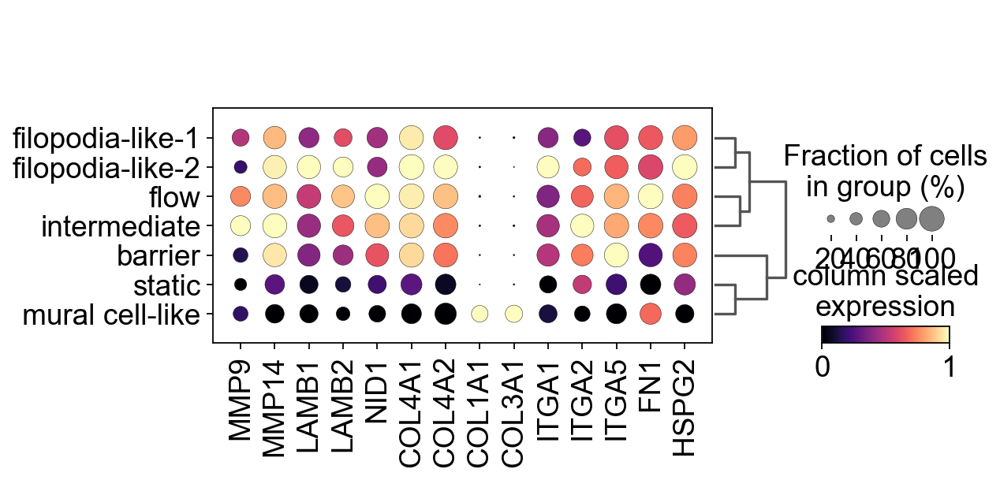

In [10]:
#ECM component genes 
ECM = ["MMP9","MMP14", "LAMB1","LAMB2", "NID1", "COL4A1", "COL4A2","COL1A1","COL3A1","ITGA1","ITGA2","ITGA5","FN1","HSPG2"]

#reference: https://www.ahajournals.org/doi/10.1161/01.res.0000191547.64391.e3 

sc.pl.dotplot(adata, ECM, groupby='cell type', dendrogram=True, cmap='magma', standard_scale='var', colorbar_title='column scaled\nexpression', save="dotplot_ECM genes.svg")
sc.pl.dotplot(adata, ECM, groupby='cell type', dendrogram=True, cmap='magma', standard_scale='var', colorbar_title='column scaled\nexpression', save="dotplot_ECM genes.png")

###### plot IHC marker

C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


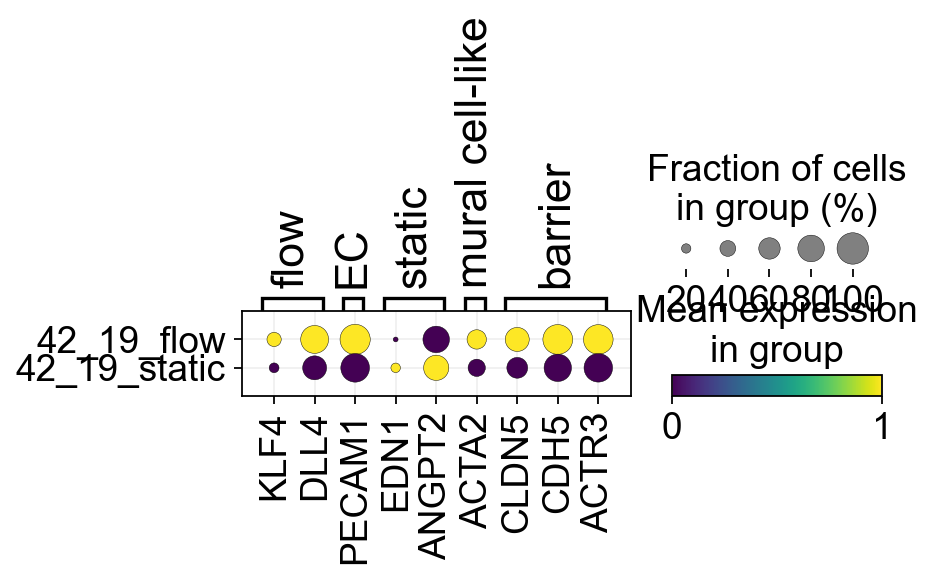

categories: barrier, flow, static, etc.
var_group_labels: flow, EC, static, etc.


C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


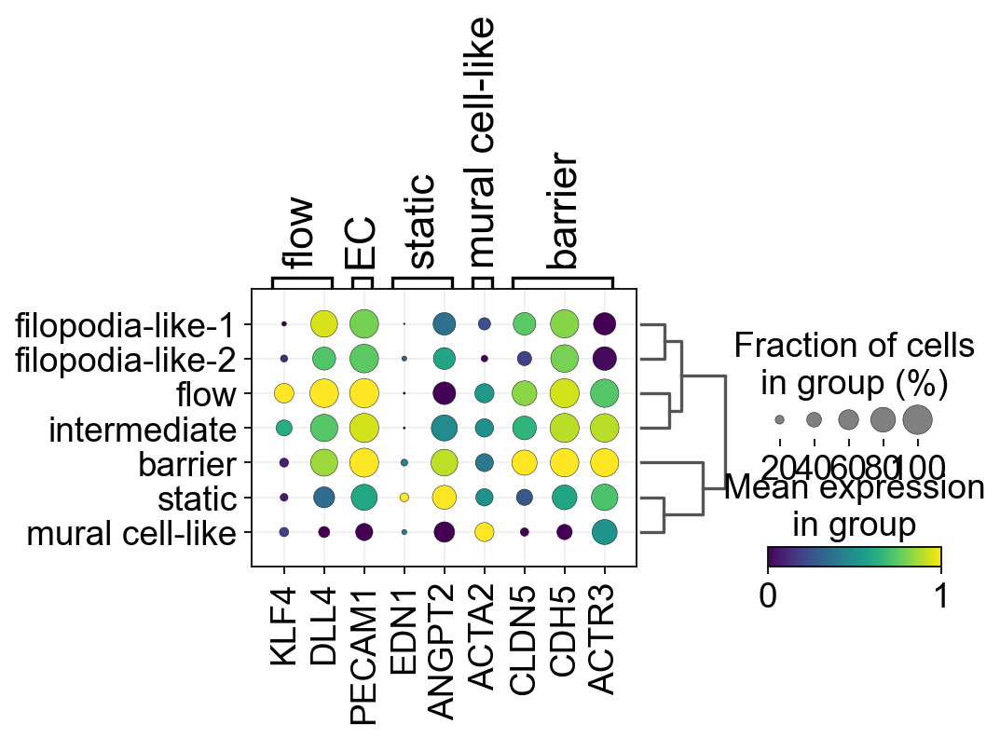

In [36]:
staining_dict = {
    "flow": ["KLF4", "DLL4"],
    "EC": ["PECAM1"],
    "static": ["EDN1", "ANGPT2"],
    "mural cell-like": [ "ACTA2"],
    "barrier": ["CLDN5", "CDH5","ACTR3"]
    
}
sc.pl.dotplot(adata, staining_dict, groupby='id', dendrogram=True, return_fig =True, cmap='magma', standard_scale='var', colorbar_title='column scaled\nexpression').style(grid=True, cmap = "viridis").legend(width = 1.8).show()
sc.pl.dotplot(adata, staining_dict, groupby='cell type', dendrogram=True, return_fig =True, cmap='magma', standard_scale='var', colorbar_title='column scaled\nexpression').style(grid=True, cmap = "viridis").legend(width = 1.8).show()

# Cell type composition

cell type,barrier,flow,static,intermediate,mural cell-like,filopodia-like-1,filopodia-like-2
id,,,,,,,
42_19_flow,0.233771,0.252091,0.188769,0.228992,0.038232,0.039427,0.018718
42_19_static,0.329670,0.060440,0.390110,0.098901,0.054945,0.016484,0.049451


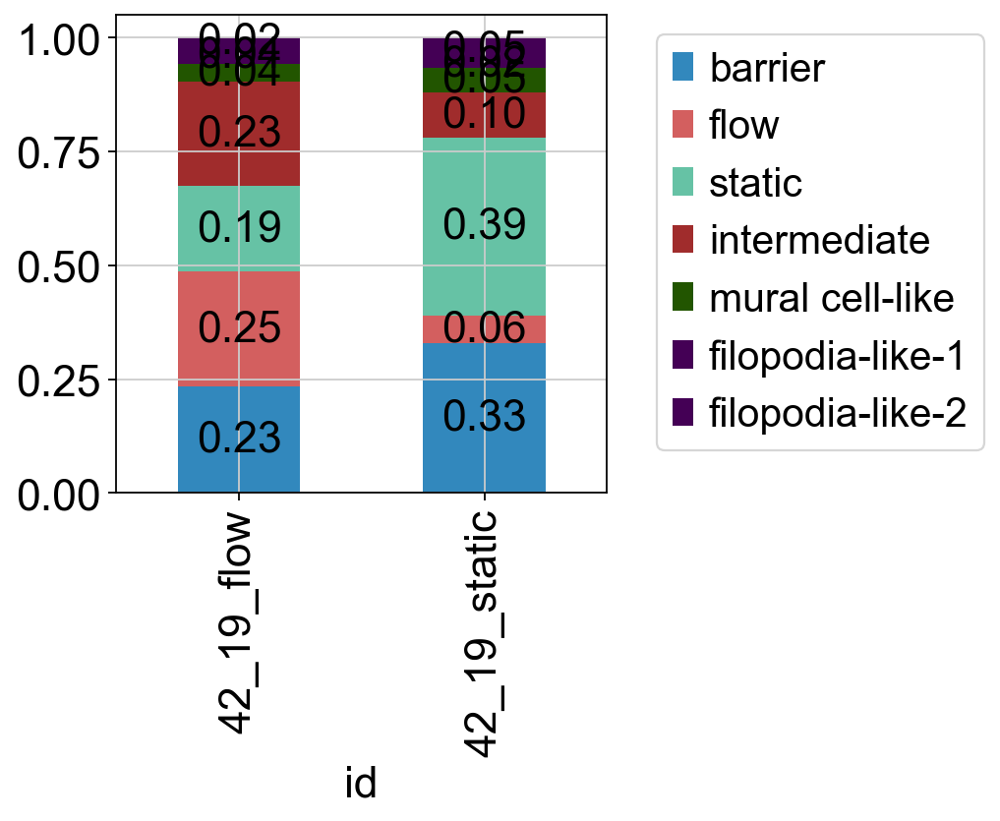

In [37]:
# cell type composition -data 
crosstab = pd.crosstab(adata.obs['id'],adata.obs["cell type"], normalize='index')
crosstab.reset_index()
ax = crosstab.plot.bar(stacked= True, color = cell_type_colors)
ax
for c in ax.containers: 
    # set the bar label
    ax.bar_label(c, label_type='center', fmt = '%.2f')

plt.legend(bbox_to_anchor=(1.06,1), loc="upper left")

crosstab

,42_19_flow
cell type,
barrier,0.233771
flow,0.252091
static,0.188769
intermediate,0.228992
mural cell-like,0.038232
filopodia-like-1,0.039427
filopodia-like-2,0.018718


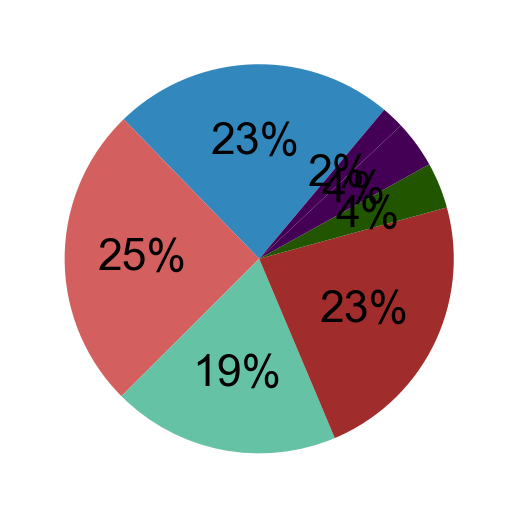

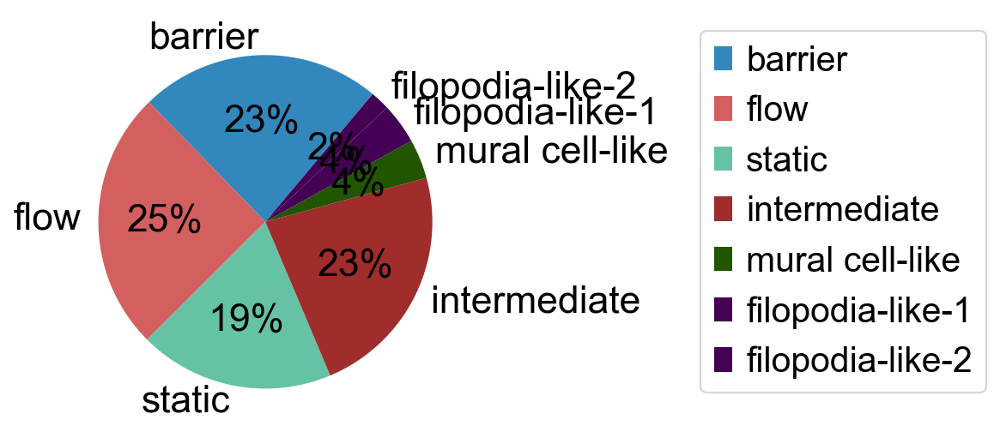

In [38]:
crosstab_flow = crosstab.iloc[0]
crosstab_flow = crosstab_flow.to_frame()

crosstab_flow.plot(kind='pie', y='42_19_flow',label = '' ,labels = None, legend =False,colors=cell_type_colors, autopct='%1.0f%%', startangle=50)
plt.savefig('cell_type proportions_flow.svg', format='svg', dpi=1200)
crosstab_flow.plot(kind='pie', y='42_19_flow',label = '' , legend =True, colors=cell_type_colors, autopct='%1.0f%%', startangle=50)
plt.legend(bbox_to_anchor=(1.5,1), loc="upper left")
crosstab_flow


,42_19_static
cell type,
barrier,0.329670
flow,0.060440
static,0.390110
intermediate,0.098901
mural cell-like,0.054945
filopodia-like-1,0.016484
filopodia-like-2,0.049451


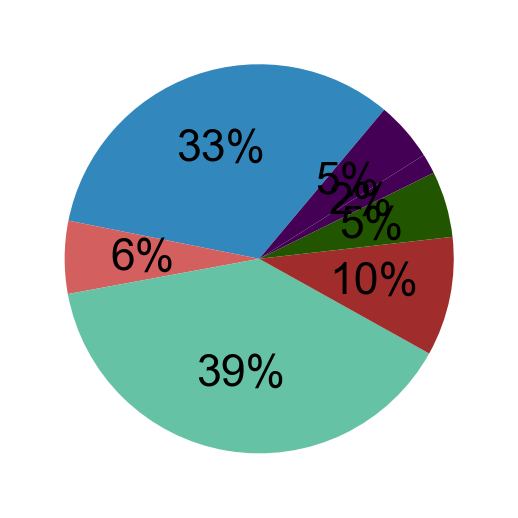

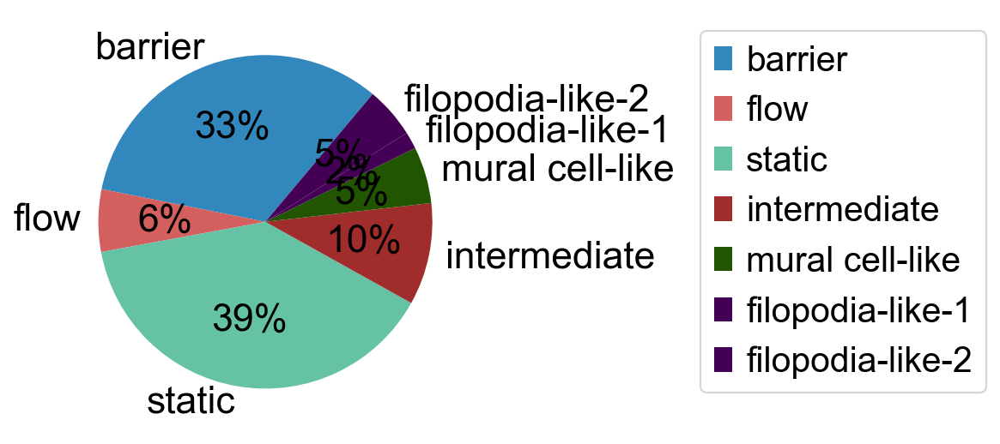

In [39]:
crosstab_static = crosstab.iloc[1]
crosstab_static = crosstab_static.to_frame()

crosstab_static.plot(kind='pie', y='42_19_static',label = '' ,labels = None, legend =False,colors=cell_type_colors, autopct='%1.0f%%', startangle=50)
plt.savefig('cell_type proportions_static.svg', format='svg', dpi=1200)
crosstab_static.plot(kind='pie', y='42_19_static',label = '' , legend =True, colors=cell_type_colors, autopct='%1.0f%%', startangle=50)
plt.legend(bbox_to_anchor=(1.5,1), loc="upper left")
crosstab_static

# Pearson correlation plot

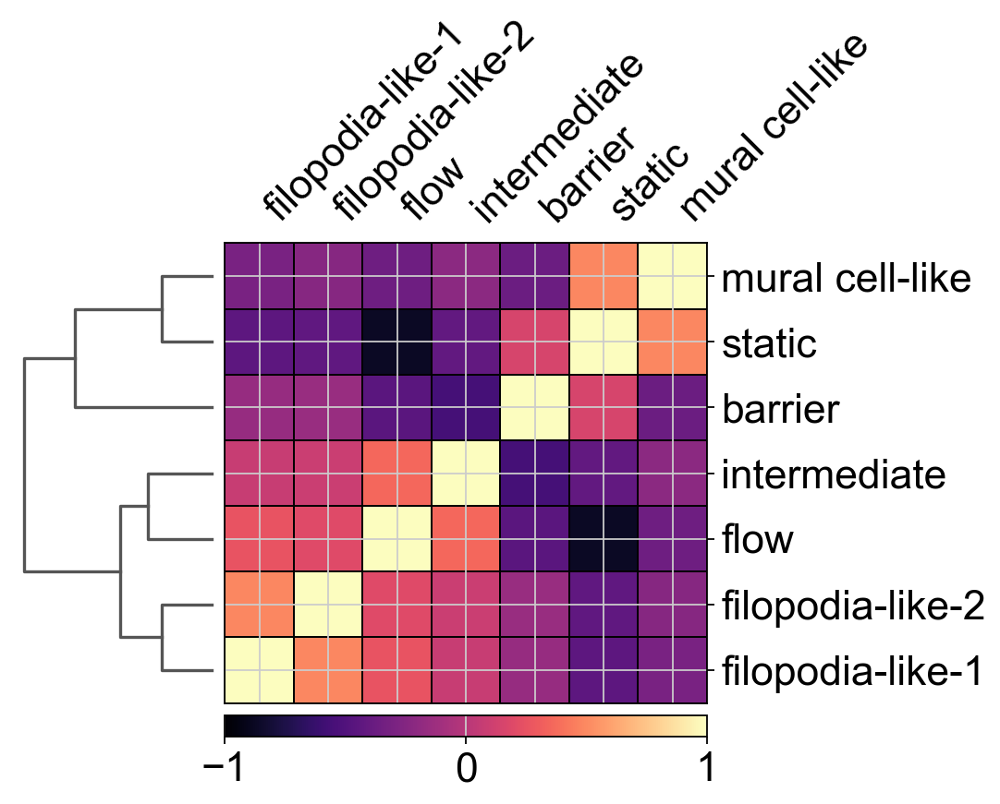

In [40]:
#pearson correlation plot 
sc.tl.dendrogram(adata, 'cell type', n_pcs=28)
sc.pl.correlation_matrix(adata, 'cell type', cmap = "magma")

# PAGA
Plot the PAGA graph through thresholding low-connectivity edges.

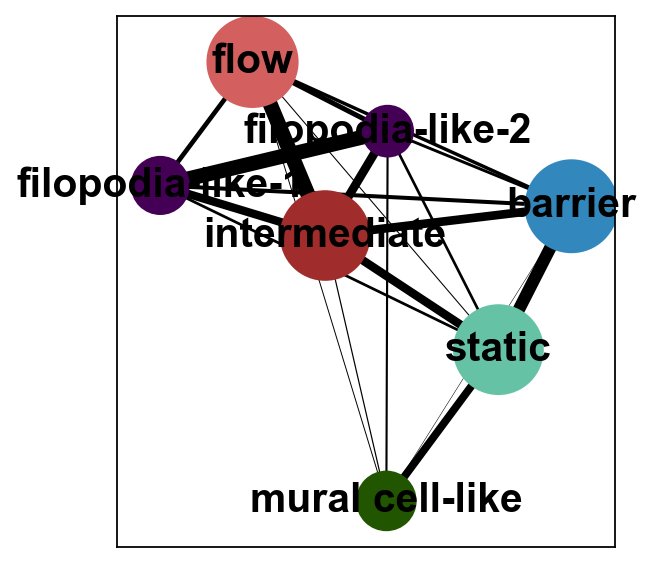

In [45]:
sc.tl.paga(adata, groups='cell type')
sc.pl.paga(adata,node_size_scale=10, edge_width_scale=2,save="PAGA.svg")

C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


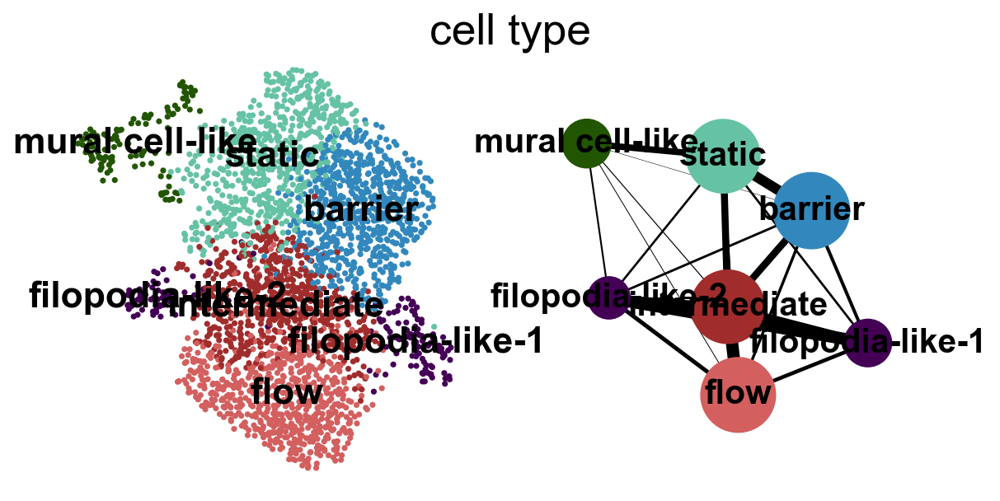

In [44]:
sc.pl.paga_compare(adata,node_size_scale=10, edge_width_scale=2, fontoutline=None)

# The NO System

In [46]:
NO = ["NOS3", 
      "CAMKK2",
      "CAMK2D",
      "CALM1",
      "NOSTRIN" ,
      "NOSIP",
       "CAV1",     
     ]


C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


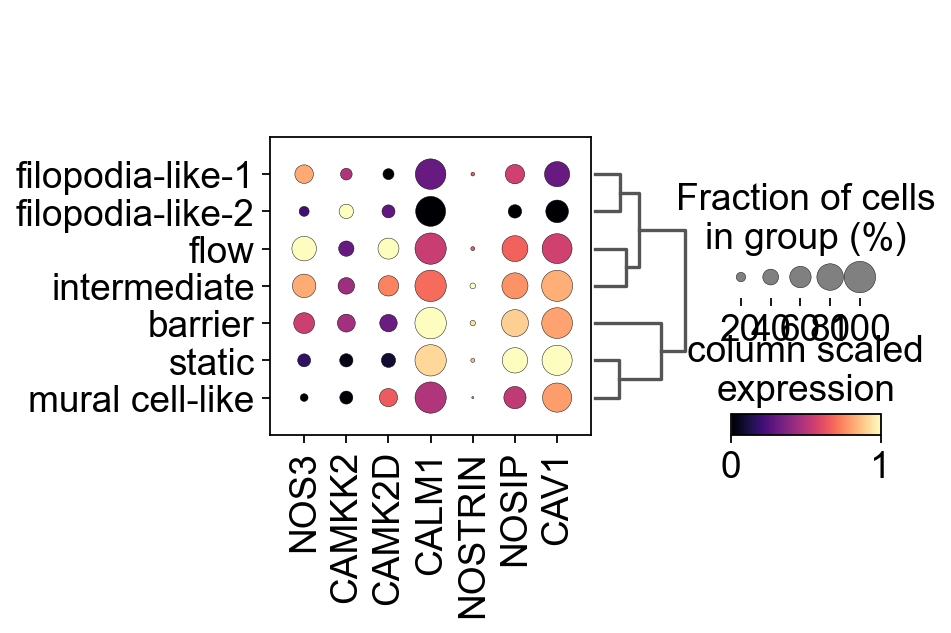

In [47]:
sc.pl.dotplot(adata, NO, 'cell type', dendrogram=True, cmap='magma', standard_scale='var', colorbar_title='column scaled\nexpression')

# KEGG pathways

original publication:
Kanehisa M, Goto S. KEGG: kyoto encyclopedia of genes and genomes. Nucleic Acids Res. 2000 Jan 1;28(1):27-30. doi: 10.1093/nar/28.1.27. PMID: 10592173; PMCID: PMC102409. https://www.ncbi.nlm.nih.gov/pmc/articles/PMC102409/

KEGG pathway list downloaded from:
https://www.genome.jp/kegg/pathway.html with the help of the R-package "KEGGREST"

KEGGREST: 
Tenenbaum D, Maintainer B (2023). KEGGREST: Client-side REST access to the Kyoto Encyclopedia of Genes and Genomes (KEGG). R package version 1.40.0.

In [57]:
import openpyxl

In [60]:
KEGGlists = pd.read_excel(r'E:\Kegg_Pathyway_genes.xlsx')

In [61]:
KEGGlists

,Glycolysis / Gluconeogenesis,Citrate cycle (TCA cycle),Pentose phosphate pathway,Pentose and glucuronate interconversions,Fructose and mannose metabolism,Galactose metabolism,Ascorbate and aldarate metabolism,Fatty acid biosynthesis,Fatty acid elongation,Fatty acid degradation,...,Systemic lupus erythematosus,Rheumatoid arthritis,Allograft rejection,Graft-versus-host disease,Primary immunodeficiency,Hypertrophic cardiomyopathy (HCM),Arrhythmogenic right ventricular cardiomyopathy (ARVC),Dilated cardiomyopathy (DCM),Viral myocarditis,Fluid shear stress and atherosclerosis
0,HK3,CS,GPI,GUSB,MPI,GALM,UGDH,ACACA,ACAA2,ACAT2,...,C1QA,CD80,HLA-A,IL6,ADA,ITGA1,ITGA1,ITGA1,CXADR,HSP90AA1
1,HK1,ACLY,G6PD,KL,PMM2,GALK1,UGT2A1,ACACB,HADHB,ACAT1,...,C1QB,CD86,HLA-B,IL1A,IL7R,ITGA2,ITGA2,ITGA2,CD55,HSP90AB1
2,HK2,ACO2,PGLS,UGT2A1,PMM1,GALT,UGT2A3,ACSF3,HADH,ACAA1,...,C1QC,CD28,HLA-C,IL1B,IL2RG,ITGA2B,ITGA2B,ITGA2B,FYN,HSP90B1
3,HKDC1,ACO1,H6PD,UGT2A3,GMPPB,GALE,UGT2B17,MCAT,HADHA,ACAA2,...,C2,CTLA4,HLA-F,TNF,JAK3,ITGA3,ITGA3,ITGA3,CAV1,NOS3
4,GCK,IDH1,PGD,UGT2B17,GMPPA,UGP2,UGT2B11,FASN,ECHS1,HADHB,...,C4A,HLA-DMA,HLA-G,HLA-DMA,DCLRE1C,ITGA4,ITGA4,ITGA4,ABL1,CAV1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
526,ALDH9A1,SDHA,PRPS1L1,UGT1A5,TPI1,SI,UGT1A10,FASN,ELOVL6,ALDH7A1,...,CTSG,ATP6V0A4,IFNG,KIR2DL1,UNG,PRKAG3,SLC8A3,LMNA,HLA-A,TNF
527,ALDH3B1,SDHB,PRPS2,UGT2B15,TKFC,GALM,UGT1A8,OXSM,ELOVL7,ALDH9A1,...,ELANE,ATP6V0A1,TNF,KIR2DL2,AICDA,PRKAG2,CDH2,IGH,HLA-B,IL1A
528,ALDH3B2,SDHC,PRPS1,UGT1A7,MPI,GALK1,UGT1A5,CBR4,HSD17B12,ACAT2,...,FCGR1A,ATP6V0D1,IL4,KIR2DL3,ICOS,ACE,JUP,ADRB1,HLA-C,IL1B
529,ALDH1A3,SDHD,RGN,UGT2B4,PMM2,GALT,UGT2B15,HSD17B8,HACD2,ACAT1,...,FCGR2A,ATP6V0D2,IL5,KIR3DL1,TNFRSF13C,IGF1,CTNNA3,GNAS,HLA-F,IFNG


C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


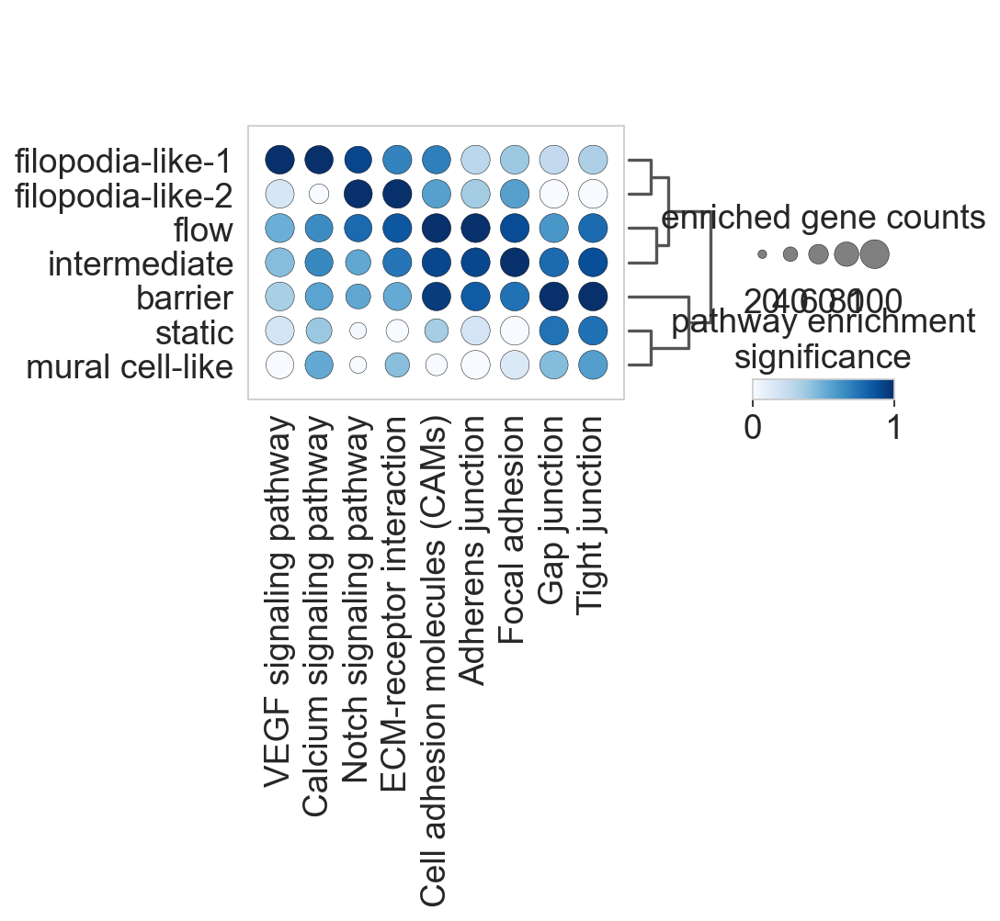

In [63]:
pathways5=['VEGF signaling pathway', 'Calcium signaling pathway', 'Notch signaling pathway','ECM-receptor interaction',
         'Cell adhesion molecules (CAMs)','Adherens junction','Focal adhesion', 'Gap junction','Tight junction' ]

for x in pathways5:
   sc.tl.score_genes(adata, gene_list=KEGGlists[x].dropna(), score_name=x,use_raw=True)

sc.pl.dotplot(adata, pathways5, groupby='cell type', dendrogram=True, cmap='Blues', standard_scale='var', colorbar_title='pathway enrichment\nsignificance',size_title = "enriched gene counts", save="dotplot_KEGG5_2023-01-12.svg")


C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


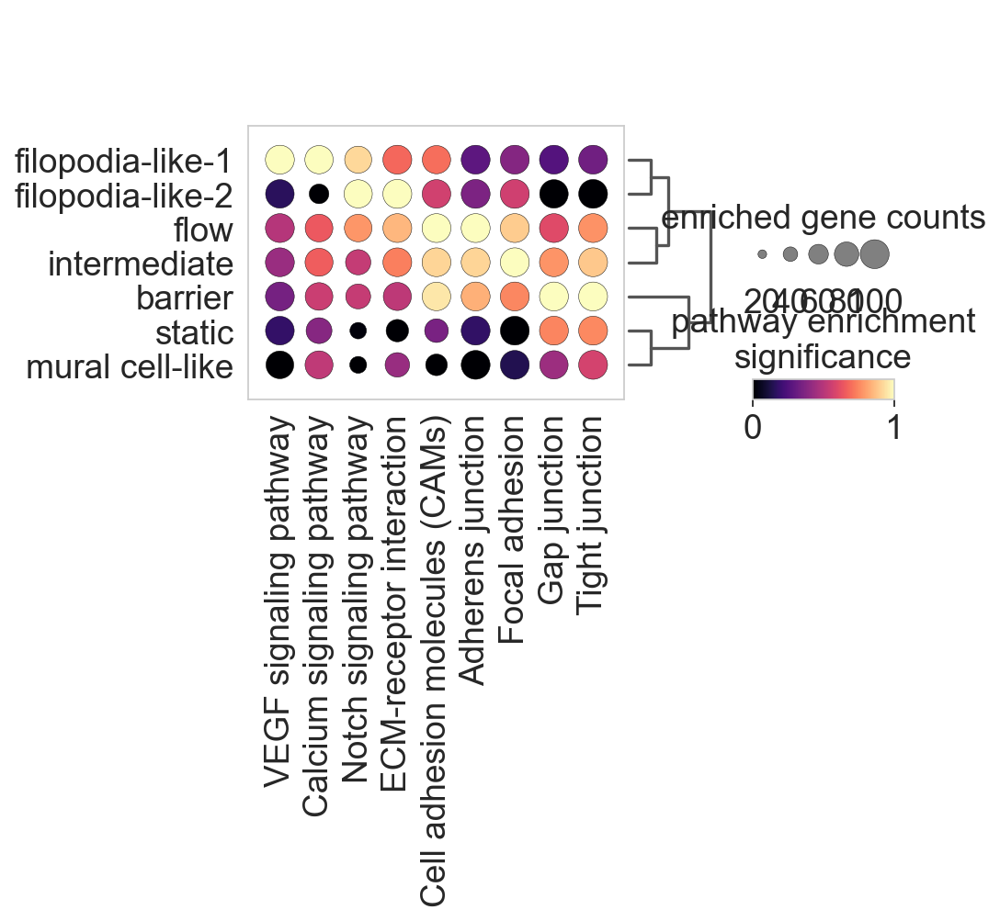

In [64]:
sc.pl.dotplot(adata, pathways5, groupby='cell type', dendrogram=True, cmap='magma', standard_scale='var', colorbar_title='pathway enrichment\nsignificance',size_title = "enriched gene counts")

# Comparision to other datasets

## Embryonic dataset
Zeng, Y., He, J., Bai, Z. et al. Tracing the first hematopoietic stem cell generation in human embryo by single-cell RNA sequencing. Cell Res 29, 881–894 (2019). https://doi.org/10.1038/s41422-019-0228-6

In [10]:
#Annotated cell types: vascular ECs with primitive and venous features (early EC), cardiac ECs (early cEC), arterial ECs (early AEC), megakaryocytic progenitors (early Mega) and erythroid progenitors (early Ery)
Zeng_top_genes_early = pd.read_excel(r"E:/Zeng_embryonic_41422_2019_228_MOESM9_ESM_sheet7.xlsx", usecols=lambda x: x != 0)

In [11]:
#top genes of early ECs to list and plotting on our dataset

Zeng_top_genes_early_list = Zeng_top_genes_early.columns.tolist()

for x in Zeng_top_genes_early_list:
    sc.tl.score_genes(adata, gene_list=Zeng_top_genes_early[x].dropna(), score_name=x,use_raw=True)

C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


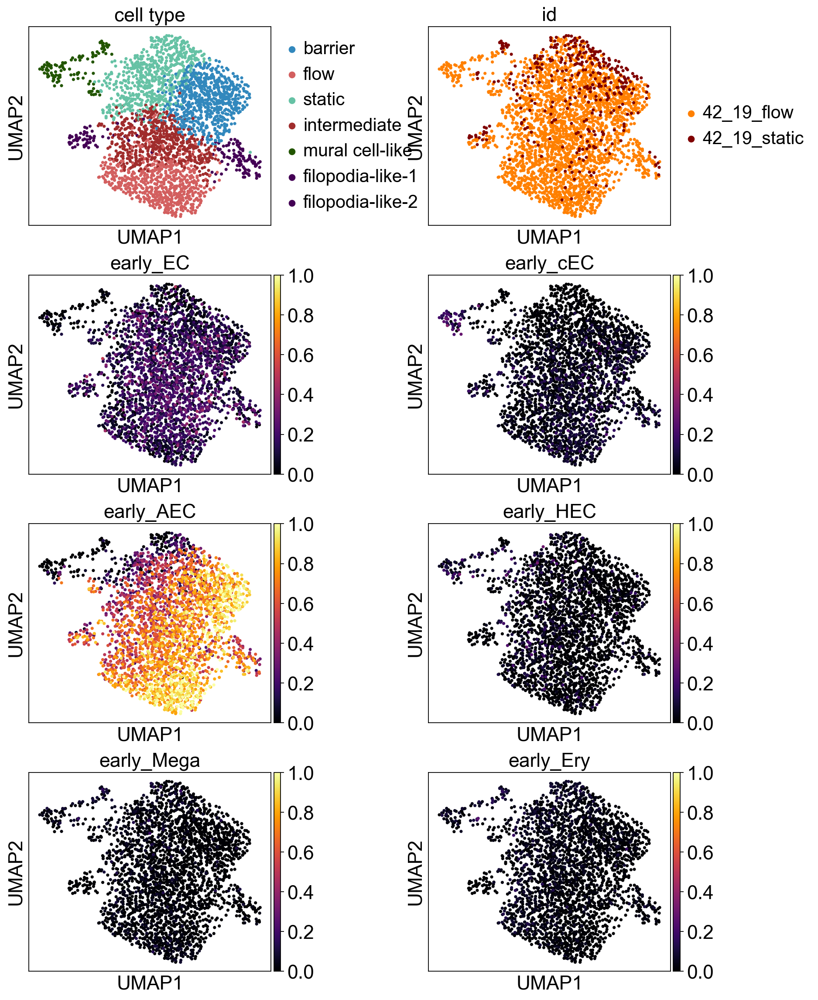

In [12]:
sc.pl.umap(adata,color=['cell type','id']+Zeng_top_genes_early_list, color_map='inferno',ncols=2,wspace=0.5,vmin=0,vmax=1,save="Zeng_embryonic.png",
          )

## Adult dataset - TS subset "vasculature"
The Tabula Sapiens Consortium* ,The Tabula Sapiens: A multiple-organ, single-cell transcriptomic atlas of humans.Science376,eabl4896(2022).https://www.science.org/doi/10.1126/science.abl4896

In [11]:
#read TS sub-dataset "vasculature" from https://figshare.com/articles/dataset/Tabula_Sapiens_release_1_0/14267219?file=40066915

TS_vasculature=sc.read_h5ad(r"E:\TS_Vasculature.h5ad")

In [12]:
TS_vasculature

AnnData object with n_obs × n_vars = 16037 × 58870
    obs: 'organ_tissue', 'method', 'donor', 'anatomical_information', 'n_counts_UMIs', 'n_genes', 'cell_ontology_class', 'free_annotation', 'manually_annotated', 'compartment', 'gender'
    var: 'gene_symbol', 'feature_type', 'ensemblid', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: '_scvi', '_training_mode', 'cell_ontology_class_colors', 'dendrogram_cell_type_tissue', 'dendrogram_computational_compartment_assignment', 'dendrogram_consensus_prediction', 'dendrogram_tissue_cell_type', 'donor_colors', 'donor_method_colors', 'hvg', 'method_colors', 'neighbors', 'organ_tissue_colors', 'sex_colors', 'tissue_colors', 'umap'
    obsm: 'X_pca', 'X_scvi', 'X_scvi_umap', 'X_umap'
    layers: 'decontXcounts', 'raw_counts'
    obsp: 'connectivities', 'distances'

C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


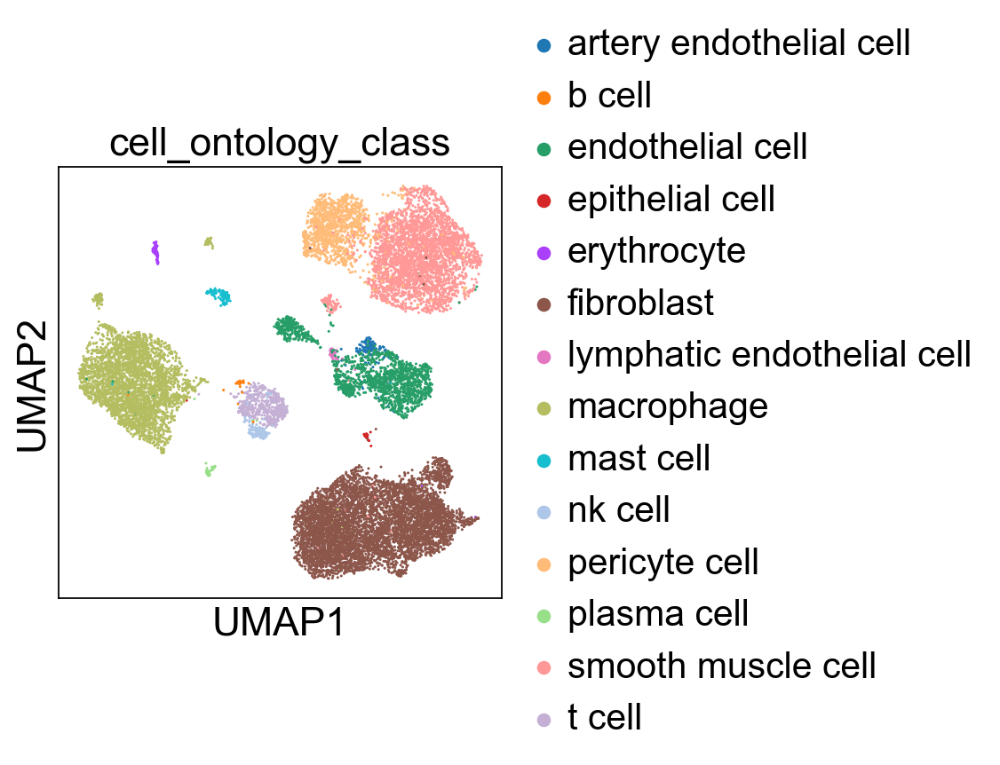

In [13]:
sc.pl.umap(TS_vasculature,color=['cell_ontology_class'])

In [14]:
#rename column 
TS_vasculature.obs.rename(columns={'cell_ontology_class':'cell type'}, inplace=True)

##### Create Subset from TS "Vasculature" datset including endothelial and perivascular cell types and score Top 500 genes on LumenChip dataset

In [29]:
#from this dataset sub-set only endothelial/mural cell types
TS_vasculature_endo = TS_vasculature[TS_vasculature.obs['cell type'].isin( [ "artery endothelial cell", "endothelial cell", "lymphatic endothelial cell", "pericyte cell", "smooth muscle cell"])]
TS_vasculature_endo

View of AnnData object with n_obs × n_vars = 6014 × 58870
    obs: 'organ_tissue', 'method', 'donor', 'anatomical_information', 'n_counts_UMIs', 'n_genes', 'cell type', 'free_annotation', 'manually_annotated', 'compartment', 'gender'
    var: 'gene_symbol', 'feature_type', 'ensemblid', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: '_scvi', '_training_mode', 'cell_ontology_class_colors', 'dendrogram_cell_type_tissue', 'dendrogram_computational_compartment_assignment', 'dendrogram_consensus_prediction', 'dendrogram_tissue_cell_type', 'donor_colors', 'donor_method_colors', 'hvg', 'method_colors', 'neighbors', 'organ_tissue_colors', 'sex_colors', 'tissue_colors', 'umap', 'cell type_colors'
    obsm: 'X_pca', 'X_scvi', 'X_scvi_umap', 'X_umap'
    layers: 'decontXcounts', 'raw_counts'
    obsp: 'connectivities', 'distances'

In [30]:
#rename column 
TS_vasculature_endo.obs.rename(columns={'cell_ontology_class':'cell type'}, inplace=True)

In [31]:
#rank Top500 genes from TS_vasculature_endo
sc.tl.rank_genes_groups(TS_vasculature_endo, 'cell type', method='t-test')
pd.DataFrame(TS_vasculature_endo.uns['rank_genes_groups']['names']).head(500)
result = TS_vasculature_endo.uns['rank_genes_groups']
groups = result['names'].dtype.names

top_500_TS_vasculature_endo  = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals']}).head(500)
top_500_TS_vasculature_endo.to_csv("t-test_ranks_TS_vasculature.csv")

C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:580: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}


C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:417: RuntimeWarning: overflow encountered in expm1
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (
C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:418: RuntimeWarning: overflow encountered in expm1
  self.expm1_func(mean_rest) + 1e-9
C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: divide by zero encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:417: RuntimeWarning: overflow encountered in expm1
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (
C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:417: RuntimeWarning: overflow encountered in expm1
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (


In [32]:
top_500_TS_vasculature_endo

,artery endothelial cell_n,artery endothelial cell_p,endothelial cell_n,endothelial cell_p,lymphatic endothelial cell_n,lymphatic endothelial cell_p,pericyte cell_n,pericyte cell_p,smooth muscle cell_n,smooth muscle cell_p
0,PODXL,5.320177e-23,SHANK3,2.467327e-113,PKHD1L1,3.514749e-12,STEAP4,2.762879e-95,OGN,2.051690e-262
1,NOTCH4,1.803614e-22,CPLX1,2.334287e-94,PPFIBP1,6.555936e-10,NOTCH3,2.170620e-95,PLN,7.691115e-236
2,PCAT19,2.758773e-21,DOC2B,5.988691e-85,MAF,2.193752e-09,SLC7A2,2.593771e-92,ITGA8,8.080256e-211
3,ICAM2,7.161830e-21,HLA-DRA,2.085106e-84,KDR,3.133579e-09,IGFBP5,1.288166e-91,SVIL,1.434069e-206
4,IFI27,1.840537e-20,RPL10P9,6.259642e-85,COLEC12,3.644058e-09,HES4,2.192377e-88,MFGE8,8.641110e-202
...,...,...,...,...,...,...,...,...,...,...
495,TET2,1.505473e-04,MT-ATP8,6.289411e-07,DOCK6,2.810761e-02,ATP5MC3,3.661129e-11,MIR4697HG,6.468816e-33
496,CUBN,1.555572e-04,NFATC2,6.761786e-07,VGLL4,3.206181e-02,PTMA,3.547939e-11,NOTCH2,6.223652e-33
497,CARD8-AS1,1.576607e-04,HLA-C,6.785863e-07,PRXL2B,3.247211e-02,AC104260.1,3.877223e-11,CLIP2,6.284488e-33
498,TLNRD1,1.579330e-04,MTRNR2L10,7.284179e-07,SLC44A3-AS1,3.255212e-02,NBL1,3.768606e-11,ABCC1,7.452908e-33


In [33]:
top_500_TS_vasculature_endo.drop(list(top_500_TS_vasculature_endo.filter(regex = "_p|Unnamed: 0")), axis=1, inplace=True)

In [34]:
top_500_TS_vasculature_endo

,artery endothelial cell_n,endothelial cell_n,lymphatic endothelial cell_n,pericyte cell_n,smooth muscle cell_n
0,PODXL,SHANK3,PKHD1L1,STEAP4,OGN
1,NOTCH4,CPLX1,PPFIBP1,NOTCH3,PLN
2,PCAT19,DOC2B,MAF,SLC7A2,ITGA8
3,ICAM2,HLA-DRA,KDR,IGFBP5,SVIL
4,IFI27,RPL10P9,COLEC12,HES4,MFGE8
...,...,...,...,...,...
495,TET2,MT-ATP8,DOCK6,ATP5MC3,MIR4697HG
496,CUBN,NFATC2,VGLL4,PTMA,NOTCH2
497,CARD8-AS1,HLA-C,PRXL2B,AC104260.1,CLIP2
498,TLNRD1,MTRNR2L10,SLC44A3-AS1,NBL1,ABCC1


In [35]:
top_500_TS_vasculature_endo_list=top_500_TS_vasculature_endo.columns.tolist()
top_500_TS_vasculature_endo_list

['artery endothelial cell_n',
 'endothelial cell_n',
 'lymphatic endothelial cell_n',
 'pericyte cell_n',
 'smooth muscle cell_n']

In [36]:
for x in top_500_TS_vasculature_endo_list:
    sc.tl.score_genes(adata, gene_list=top_500_TS_vasculature_endo[x].dropna(), score_name=x,use_raw=True)

C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
C:\Users\MarenMarder\anaconda3\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


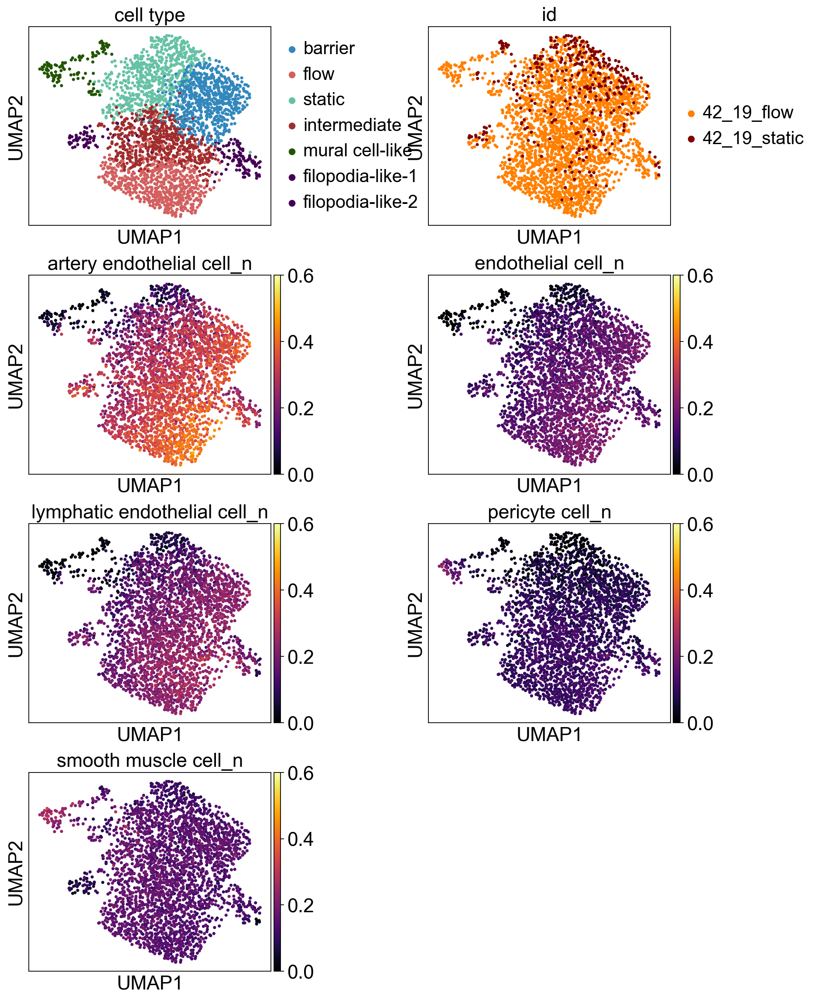

In [37]:
sc.pl.umap(adata,color=['cell type',"id"]+top_500_TS_vasculature_endo_list, color_map='inferno',ncols=2,wspace=0.5, 
           vmin= 0, vmax=0.6, save='TS_vasculature.svg'
          )